<a href="https://colab.research.google.com/github/CesarAugusto88/dissertation/blob/main/Test_Landslides_Petropolis_INPE.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<h2 style="text-align:center">
Instituto Nacional de Pesquisas Espaciais, INPE <br>
Graduado em Computação Aplicada, CAP <br>

Autor: Cesar Augusto de Moraes Costa

Data: 22/11/2023

#1: Introdução: Notebook para teste de inferência do modelo U-Net para a área de estudo Petrópolis - RJ.

### O objetivo do projeto foi utilizar a arquitetura U-Net treinada para o domínio de desastre de deslizamentos de terra ocorrido em São Sebastião, litoral norte de São Paulo, onde ocorreu diversos escorregamentos de terra, conseguindo obter um dataset balanceado, para classificar os dados de deslizamentos ocorrido em Petrópolis.

## 2: Configurações iniciais.

### Carregar imagens contidas no drive


In [1]:
# Download de arquivos
# 2021
!gdown --id --folder 1iCCAFv6IEzn8Jc3Qfx0A3-WMjMRswmeq -q
# 2022
!gdown --id --folder 1ATgkq4txtQW69Q3My_pog00qDGjq2tsm -q

/usr/local/lib/python3.10/dist-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(


In [2]:
# Instalar pacote Rasterio
!pip install rasterio -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.6/20.6 MB 50.0 MB/s eta 0:00:00


## 3: Imagens 2021 - Carregamento de imagens raster, sistema de referência, transformação afim, usando os pacote gdal e rasterio para Python [1].

In [3]:
from osgeo import gdal
# IMAGES 2021
p0 = '/content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b0.tif'
img0 = gdal.Open(p0)
r0 = img0.GetGeoTransform()
print(r0)
p1 = '/content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b1.tif'
img1 = gdal.Open(p1)
r1 = img1.GetGeoTransform()
print(r1)
p2 = '/content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b2.tif'
img2 = gdal.Open(p2)
r2 = img2.GetGeoTransform()
print(r2)
p3 = '/content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b3.tif'
img3 = gdal.Open(p3)
r3 = img3.GetGeoTransform()
print(r3)
p4 = '/content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b4.tif'
img4 = gdal.Open(p4)
r4 = img4.GetGeoTransform()
print(r4)

(686716.0, 2.0, 0.0, 7509824.0, 0.0, -2.0)
(686712.0, 8.0, 0.0, 7509826.0, 0.0, -8.0)
(686712.0, 8.0, 0.0, 7509826.0, 0.0, -8.0)
(686712.0, 8.0, 0.0, 7509826.0, 0.0, -8.0)
(686712.0, 8.0, 0.0, 7509826.0, 0.0, -8.0)


In [4]:
import rasterio
from pathlib import Path
import matplotlib.pyplot as plt
import numpy as np
from osgeo import gdal
gdal.__version__,rasterio.__version__

('3.4.3', '1.3.9')

In [5]:
def load_cbers_image(img_folder, bands):
    # initialize the dictionaries
    image = {}
    ds = {}

    path = Path(img_folder)

    # loop through the given bands to load
    for band in bands:
        # considering the cbers images end with *_SR_B#.TIF, we will use it to locate the correct file
        file = next(path.glob(f'*{band}.tif'))
        print(f'Opening file {file}')
        ds.update({band: rasterio.open(file)})
        image.update({band: ds[band].read(1)})

    return image, ds



Opening file /content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b0.tif
Opening file /content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b1.tif
Opening file /content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b2.tif
Opening file /content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b3.tif


Opening file /content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b4.tif


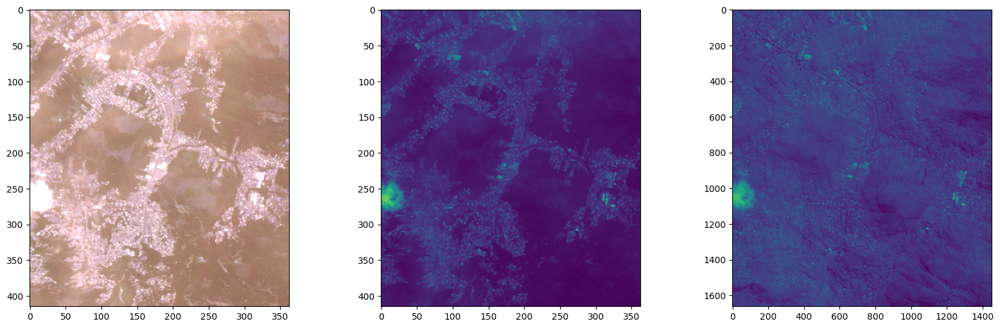

In [6]:
# load the image
img, image_ds = load_cbers_image('/content/recortes_20210328/',
                                   ['CBERS_4A_WPM_20210328_198_141_L4_b0',
                                    'CBERS_4A_WPM_20210328_198_141_L4_b1',
                                    'CBERS_4A_WPM_20210328_198_141_L4_b2',
                                    'CBERS_4A_WPM_20210328_198_141_L4_b3',
                                    'CBERS_4A_WPM_20210328_198_141_L4_b4'])
# create image - BGRNIR
BGRNIR = np.stack([img['CBERS_4A_WPM_20210328_198_141_L4_b1'],
                    img['CBERS_4A_WPM_20210328_198_141_L4_b2'],
                    img['CBERS_4A_WPM_20210328_198_141_L4_b3'],
                    img['CBERS_4A_WPM_20210328_198_141_L4_b4']], axis=2)
BGRNIR = BGRNIR / BGRNIR.max()

# load bands 1 and 0
b0_ds = rasterio.open('/content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b0.tif')
b1_ds = rasterio.open('/content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b1.tif')

b0_array = b0_ds.read(1)
b1_array = b1_ds.read(1)

# Plot the 3 images
fig, ax = plt.subplots(1, 3, figsize=(20, 6))
ax[0].imshow(BGRNIR*3)

ax[1].imshow(b1_array);
ax[2].imshow(b0_array)

In [7]:
print(BGRNIR.shape, b1_array.shape, b0_array.shape)

(415, 363, 4) (415, 363) (1662, 1452)


##3.1: Sistema de Referência de Coordenadas CRS

In [8]:
print('Band Green B2: \n', image_ds['CBERS_4A_WPM_20210328_198_141_L4_b2'].profile)
print('Band Blue B1: \n', b1_ds.profile)
print('Band Pan  B0: \n', b0_ds.profile)

Band Green B2: 
 {'driver': 'GTiff', 'dtype': 'int16', 'nodata': 0.0, 'width': 363, 'height': 415, 'count': 1, 'crs': CRS.from_epsg(32723), 'transform': Affine(8.0, 0.0, 686712.0,
       0.0, -8.0, 7509826.0), 'blockysize': 11, 'tiled': False, 'interleave': 'band'}
Band Blue B1: 
 {'driver': 'GTiff', 'dtype': 'int16', 'nodata': 0.0, 'width': 363, 'height': 415, 'count': 1, 'crs': CRS.from_epsg(32723), 'transform': Affine(8.0, 0.0, 686712.0,
       0.0, -8.0, 7509826.0), 'blockysize': 11, 'tiled': False, 'interleave': 'band'}
Band Pan  B0: 
 {'driver': 'GTiff', 'dtype': 'int16', 'nodata': 0.0, 'width': 1452, 'height': 1662, 'count': 1, 'crs': CRS.from_epsg(32723), 'transform': Affine(2.0, 0.0, 686716.0,
       0.0, -2.0, 7509824.0), 'blockysize': 2, 'tiled': False, 'interleave': 'band'}


##3.2: Salvar imagem com sistema de referências
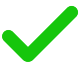

In [9]:
from osgeo import gdal
dataset = gdal.Open("/content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b2.tif", gdal.GA_ReadOnly)
type(dataset)

osgeo.gdal.Dataset

In [10]:
GT = dataset.GetGeoTransform()

print(type(BGRNIR))

dst_crs='EPSG:32723'
print(BGRNIR.shape)

<class 'numpy.ndarray'>
(415, 363, 4)


In [11]:
saida2021BGRNIR = np.float32(BGRNIR)

In [12]:
print(GT)

(686712.0, 8.0, 0.0, 7509826.0, 0.0, -8.0)


In [13]:
from affine import Affine
transf = (686712.0, 8.0, 0.0, 7509826.0, 0.0, -8.0)
af_transf = Affine.from_gdal(*transf)
print(af_transf)

| 8.00, 0.00, 686712.00|
| 0.00,-8.00, 7509826.00|
| 0.00, 0.00, 1.00|


In [14]:
saida2021BGRNIR.shape

(415, 363, 4)

In [15]:
print(saida2021BGRNIR.shape[0], saida2021BGRNIR.shape[1], saida2021BGRNIR.shape[2])

415 363 4


In [16]:
with rasterio.open('image2021.tif', 'w',
                  driver='GTiff',
                  height=saida2021BGRNIR.shape[0],
                  width=saida2021BGRNIR.shape[1],
                  count=saida2021BGRNIR.shape[2],
                  dtype=np.float32,
                  crs=dst_crs,
                  transform=af_transf) as dst:
    # If saida2021BGRNIR is in (y, x, z) order (rows, cols, bands)
    dst.write(np.moveaxis(saida2021BGRNIR, [0, 1, 2], [1, 2, 0]))

In [17]:
img = gdal.Open('/content/image2021.tif')
r = img.GetGeoTransform()
print(r)

(686712.0, 8.0, 0.0, 7509826.0, 0.0, -8.0)


(4, 415, 363) (415, 363, 4)


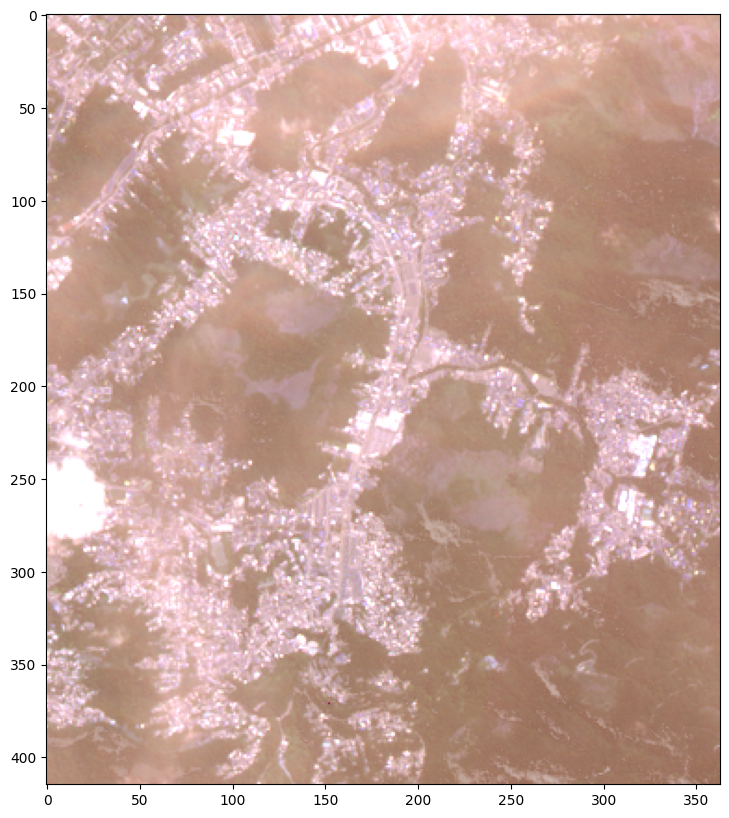

In [18]:
img_array = rasterio.open('/content/image2021.tif').read()
img_array_ = np.transpose(img_array, (1, 2, 0))
print(img_array.shape, img_array_.shape)
plt.figure(figsize=(10, 10))
plt.imshow(img_array_*3);

##3.3 Criando pansharpening

In [19]:
!pip install -q gdal-utils

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 337.7/337.7 kB 6.8 MB/s eta 0:00:00


In [20]:
# pansharpening
# For GDAL >= 3.3:
# from osgeo.osgeo_utils import gdal_pansharpen
from osgeo_utils.gdal_pansharpen import gdal_pansharpen
gdal_pansharpen(
    pan_name='/content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b0.tif',
    spectral_names=['/content/image2021.tif'],
    band_nums=[1, 2, 3, 4],
    dst_filename='output_pansharpened2021BGRNIR.tif')

0

In [21]:
img_array = rasterio.open('/content/output_pansharpened2021BGRNIR.tif').read()
# img_array_ = np.transpose(img_array, (1, 2, 0))
# print(img_array.shape, img_array_.shape)
print(img_array.shape)
# plt.figure(figsize=(10, 10))
# plt.imshow(img_array_);

(4, 1662, 1452)


(1662, 1452, 4)


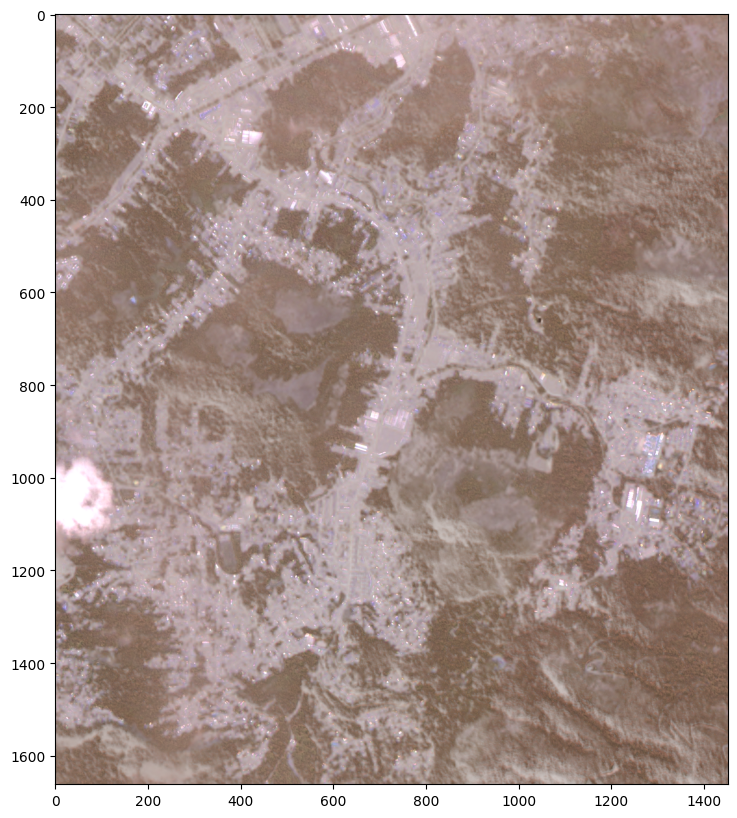

In [22]:
pansharp2021 = rasterio.open('/content/output_pansharpened2021BGRNIR.tif').read()

# pansharp2021 = np.stack([pansharp2021[0],pansharp2021[1],
#                   pansharp2021[2],pansharp2021[3]], axis=2)
# pansharp2021 = np.stack(pansharp2021, axis=2)
pansharp2021 = np.dstack(pansharp2021)

print(pansharp2021.shape)

rgb2021_pansharp = pansharp2021 / pansharp2021.max()
plt.figure(figsize=(10, 10))
plt.imshow(rgb2021_pansharp*3)

In [23]:
dataset2021 = gdal.Open("/content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b0.tif", gdal.GA_ReadOnly)
GT2021 = dataset2021.GetGeoTransform()
print(GT2021)

(686716.0, 2.0, 0.0, 7509824.0, 0.0, -2.0)


####2.3.1: Transf Affine 2021 and 2022

In [24]:
from affine import Affine
transf2021_2022 = (686716.0, 2.0, 0.0, 7509824.0, 0.0, -2.0)
af_transf2021_2022 = Affine.from_gdal(*transf2021_2022)
print(af_transf2021_2022)

| 2.00, 0.00, 686716.00|
| 0.00,-2.00, 7509824.00|
| 0.00, 0.00, 1.00|


##3.4: Mostrando Imagens: RGB, RGNIR e Pansharpening

Opening file /content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b1.tif
Opening file /content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b2.tif
Opening file /content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b3.tif
Opening file /content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b1.tif
Opening file /content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b2.tif
Opening file /content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b3.tif
Opening file /content/recortes_20210328/CBERS_4A_WPM_20210328_198_141_L4_b4.tif


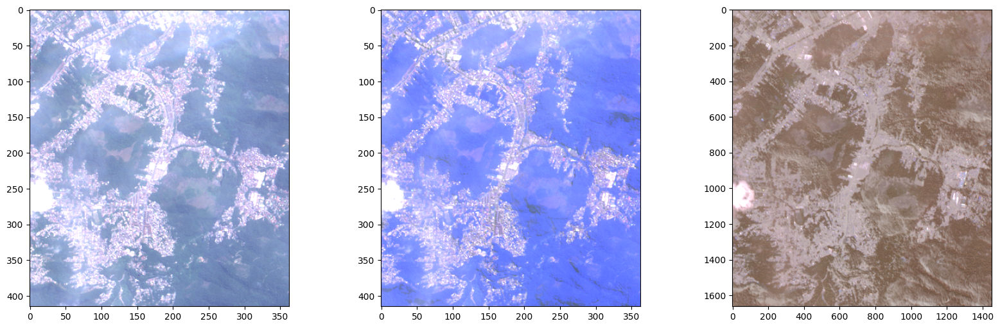

In [25]:
# load the image
img, image_ds = load_cbers_image('/content/recortes_20210328/',
                                   ['CBERS_4A_WPM_20210328_198_141_L4_b1',
                                    'CBERS_4A_WPM_20210328_198_141_L4_b2',
                                    'CBERS_4A_WPM_20210328_198_141_L4_b3'])
# create the RGB for the image
rgb = np.stack([img['CBERS_4A_WPM_20210328_198_141_L4_b3'],
                img['CBERS_4A_WPM_20210328_198_141_L4_b2'],
                img['CBERS_4A_WPM_20210328_198_141_L4_b1']], axis=2)
rgb = rgb / rgb.max()

# load the image
img_rgbnir, image_rgbnir_ds = load_cbers_image('/content/recortes_20210328/',
                                   ['CBERS_4A_WPM_20210328_198_141_L4_b1',
                                    'CBERS_4A_WPM_20210328_198_141_L4_b2',
                                    'CBERS_4A_WPM_20210328_198_141_L4_b3',
                                    'CBERS_4A_WPM_20210328_198_141_L4_b4'])
# create the RG NIR for the image
rg_nir = np.stack([img_rgbnir['CBERS_4A_WPM_20210328_198_141_L4_b3'],
                    img_rgbnir['CBERS_4A_WPM_20210328_198_141_L4_b2'],
                    img_rgbnir['CBERS_4A_WPM_20210328_198_141_L4_b4']], axis=2)
rg_nir = rg_nir / rg_nir.max()

# load image

pansharp = rasterio.open('/content/output_pansharpened2021BGRNIR.tif').read()
pansharp = np.dstack(pansharp)
pansharp = pansharp / pansharp.max()
# print(pansharp[1])
# Plot the 3 images
fig, ax = plt.subplots(1, 3, figsize=(20, 6));
ax[0].imshow(rgb*3)
ax[1].imshow(rg_nir*3)
ax[2].imshow(pansharp*3);

In [26]:
print(rgb.shape, rg_nir.shape, pansharp.shape)

(415, 363, 3) (415, 363, 3) (1662, 1452, 4)


##4: Imagens 2022 - Carregamento de imagens raster, sistema de referência, transformação afim, usando os pacote gdal e rasterio para Python [1].

In [27]:
from osgeo import gdal
# IMAGES 2022
p0 = '/content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b0.tif'
img0 = gdal.Open(p0)
r0 = img0.GetGeoTransform()
print(r0)
p1 = '/content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b1.tif'
img1 = gdal.Open(p1)
r1 = img1.GetGeoTransform()
print(r1)
p2 = '/content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b2.tif'
img2 = gdal.Open(p2)
r2 = img2.GetGeoTransform()
print(r2)
p3 = '/content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b3.tif'
img3 = gdal.Open(p3)
r3 = img3.GetGeoTransform()
print(r3)
p4 = '/content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b4.tif'
img4 = gdal.Open(p4)
r4 = img4.GetGeoTransform()
print(r4)

(686714.0, 2.0, 0.0, 7509822.0, 0.0, -2.0)
(686714.0, 8.0, 0.0, 7509822.0, 0.0, -8.0)
(686714.0, 8.0, 0.0, 7509822.0, 0.0, -8.0)
(686714.0, 8.0, 0.0, 7509822.0, 0.0, -8.0)
(686714.0, 8.0, 0.0, 7509822.0, 0.0, -8.0)


Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b1.tif
Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b2.tif
Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b3.tif


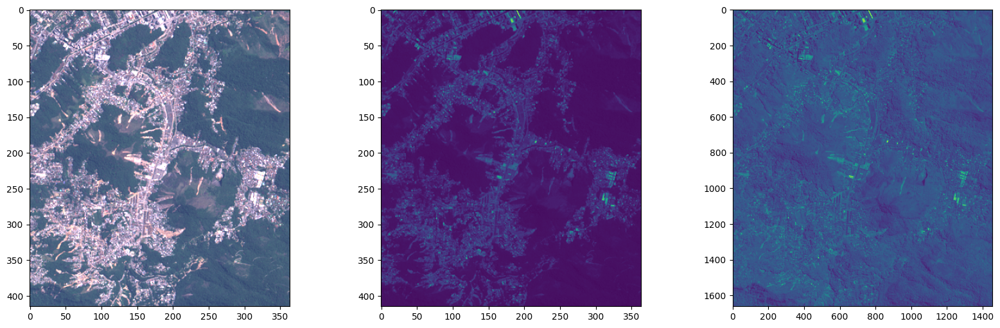

In [28]:
# load the image
img2022, image2022_ds = load_cbers_image('/content/recortes_20220304/',
                                   ['cbers4a_wpm_20220304_198_141_l4_b1',
                                    'cbers4a_wpm_20220304_198_141_l4_b2',
                                    'cbers4a_wpm_20220304_198_141_l4_b3'])
# create the RGB for the image
rgb2022 = np.stack([img2022['cbers4a_wpm_20220304_198_141_l4_b3'],
                img2022['cbers4a_wpm_20220304_198_141_l4_b2'],
                img2022['cbers4a_wpm_20220304_198_141_l4_b1']], axis=2)
rgb2022 = rgb2022 / rgb2022.max()

# load bands 1 and 0
b0_2022_ds = rasterio.open('/content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b0.tif')
b1_2022_ds = rasterio.open('/content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b1.tif')

b0_2022_array = b0_2022_ds.read(1)
b1_2022_array = b1_2022_ds.read(1)

# Plot the 3 images
fig, ax = plt.subplots(1, 3, figsize=(20, 6));
ax[0].imshow(rgb2022*3)

ax[1].imshow(b1_2022_array);
ax[2].imshow(b0_2022_array)

Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b0.tif
Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b1.tif
Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b2.tif
Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b3.tif
Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b4.tif


(-0.5, 1454.5, 1661.5, -0.5)

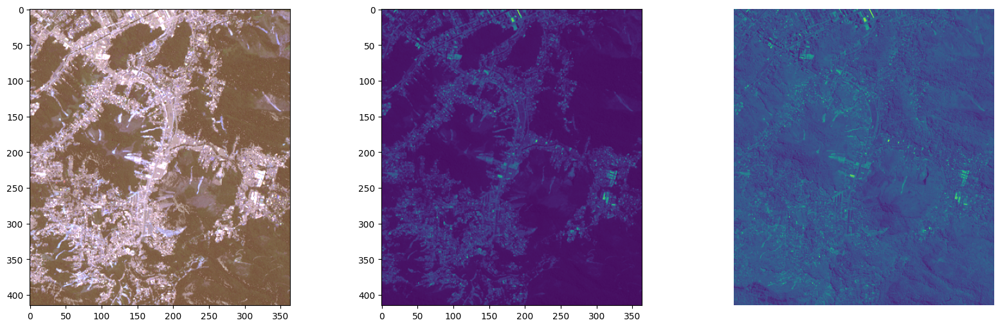

In [29]:
# load the image
img2022, image2022_ds = load_cbers_image('/content/recortes_20220304/',
                                   ['cbers4a_wpm_20220304_198_141_l4_b0',
                                    'cbers4a_wpm_20220304_198_141_l4_b1',
                                    'cbers4a_wpm_20220304_198_141_l4_b2',
                                    'cbers4a_wpm_20220304_198_141_l4_b3',
                                    'cbers4a_wpm_20220304_198_141_l4_b4'])
# create the RGBNIR for the image - BGRNIR
rgb2022_nir = np.stack([img2022['cbers4a_wpm_20220304_198_141_l4_b1'],
                       img2022['cbers4a_wpm_20220304_198_141_l4_b2'],
                       img2022['cbers4a_wpm_20220304_198_141_l4_b3'],
                       img2022['cbers4a_wpm_20220304_198_141_l4_b4']], axis=2)
rgb2022_nir = rgb2022_nir / rgb2022_nir.max()

# load bands 1 and 0
b0_2022_ds = rasterio.open('/content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b0.tif')
b1_2022_ds = rasterio.open('/content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b1.tif')

b0_2022_array = b0_2022_ds.read(1)
b1_2022_array = b1_2022_ds.read(1)

# Plot the 3 images
fig, ax = plt.subplots(1, 3, figsize=(20, 6))
ax[0].imshow(rgb2022_nir*3)
ax[1].imshow(b1_2022_array);
ax[2].imshow(b0_2022_array);
plt.axis('off')

##4.1: Sistema de Referência de Coordenadas CRS

In [30]:
print('Band Green B2: \n', image2022_ds['cbers4a_wpm_20220304_198_141_l4_b2'].profile)
print('Band Pan  B0: \n', b0_2022_ds.profile)
print('Band Blue B1: \n', b1_2022_ds.profile)

Band Green B2: 
 {'driver': 'GTiff', 'dtype': 'int16', 'nodata': 0.0, 'width': 364, 'height': 415, 'count': 1, 'crs': CRS.from_epsg(32723), 'transform': Affine(8.0, 0.0, 686714.0,
       0.0, -8.0, 7509822.0), 'blockysize': 11, 'tiled': False, 'interleave': 'band'}
Band Pan  B0: 
 {'driver': 'GTiff', 'dtype': 'int16', 'nodata': 0.0, 'width': 1455, 'height': 1662, 'count': 1, 'crs': CRS.from_epsg(32723), 'transform': Affine(2.0, 0.0, 686714.0,
       0.0, -2.0, 7509822.0), 'blockysize': 2, 'tiled': False, 'interleave': 'band'}
Band Blue B1: 
 {'driver': 'GTiff', 'dtype': 'int16', 'nodata': 0.0, 'width': 364, 'height': 415, 'count': 1, 'crs': CRS.from_epsg(32723), 'transform': Affine(8.0, 0.0, 686714.0,
       0.0, -8.0, 7509822.0), 'blockysize': 11, 'tiled': False, 'interleave': 'band'}


##4.2: Salvando imagens com sistema de referências
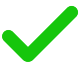

In [31]:
from osgeo import gdal
dataset2022 = gdal.Open("/content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b2.tif", gdal.GA_ReadOnly)
type(dataset2022)

osgeo.gdal.Dataset

In [32]:
GT2022 = dataset2022.GetGeoTransform()

print(type(rgb2022_nir))

dst_crs='EPSG:32723'
print(rgb2022_nir.shape)

<class 'numpy.ndarray'>
(415, 364, 4)


In [33]:
saida2022 = np.float32(rgb2022_nir)

In [34]:
print(GT2022)

(686714.0, 8.0, 0.0, 7509822.0, 0.0, -8.0)


In [35]:
from affine import Affine
transf2022 = (686714.0, 8.0, 0.0, 7509822.0, 0.0, -8.0)
af_transf2022 = Affine.from_gdal(*transf2022)
print(af_transf2022)

| 8.00, 0.00, 686714.00|
| 0.00,-8.00, 7509822.00|
| 0.00, 0.00, 1.00|


In [36]:
saida2022.shape

(415, 364, 4)

In [37]:
print(saida2022.shape[0], saida2022.shape[1], saida2022.shape[2])

415 364 4


In [38]:
with rasterio.open('image2022.tif', 'w',
                  driver='GTiff',
                  height=saida2022.shape[0],
                  width=saida2022.shape[1],
                  count=saida2022.shape[2],
                  dtype=np.float32,
                  crs=dst_crs,
                  transform=af_transf2022) as dst:
    # If saida2022 is in (y, x, z) order (rows, cols, bands)
    dst.write(np.moveaxis(saida2022, [0, 1, 2], [1, 2, 0]))

In [39]:
img = gdal.Open('/content/image2022.tif')
r = img.GetGeoTransform()
print(r)

(686714.0, 8.0, 0.0, 7509822.0, 0.0, -8.0)


(4, 415, 364) (415, 364, 4)


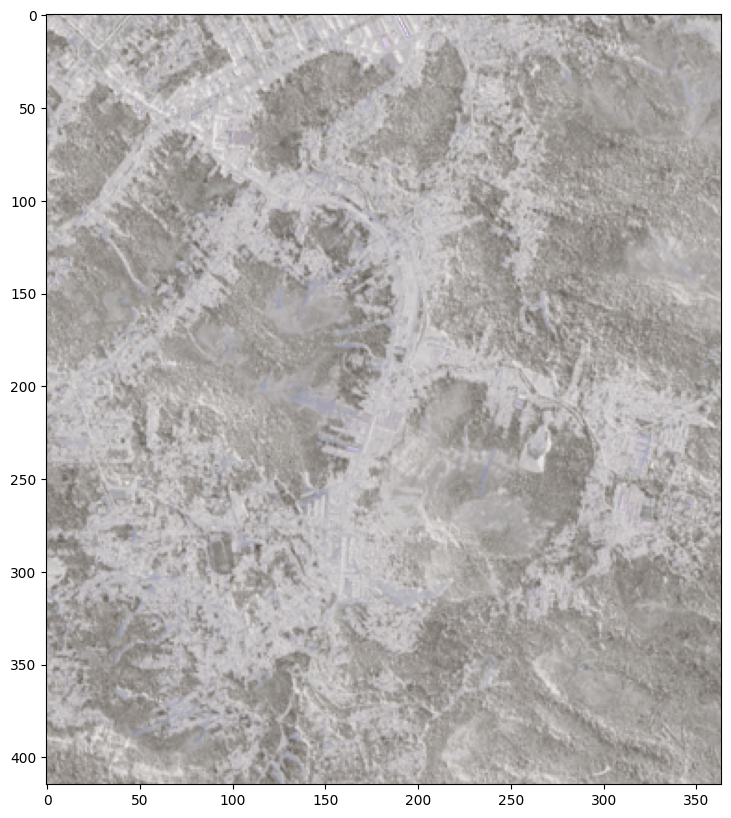

In [40]:
img2022_array = rasterio.open('/content/image2022.tif').read()
img2022_array_ = np.transpose(img2022_array, (1, 2, 0))
print(img2022_array.shape, img2022_array_.shape)
plt.figure(figsize=(10, 10))
plt.imshow(img2022_array_);

##4.3: Criando pansharpening

In [41]:
# pansharpening
# For GDAL >= 3.3:
# from osgeo.osgeo_utils import gdal_pansharpen
from osgeo_utils.gdal_pansharpen import gdal_pansharpen
gdal_pansharpen(
    pan_name='/content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b0.tif',
    spectral_names=['/content/image2022.tif'],
    band_nums=[1, 2, 3, 4],
    dst_filename='output2022_pansharpenedBGRNIR.tif')

0

In [42]:
img2022_array = rasterio.open('/content/output2022_pansharpenedBGRNIR.tif').read()
# img2022_array_ = np.transpose(img2022_array, (1, 2, 0))
# print(img2022_array.shape, img2022_array_.shape)
# plt.figure(figsize=(10, 10))
# plt.imshow(img2022_array_);
print(img2022_array.shape, img_array.shape)  # 4, 1662, 1452

(4, 1662, 1455) (4, 1662, 1452)


(1662, 1455, 4)


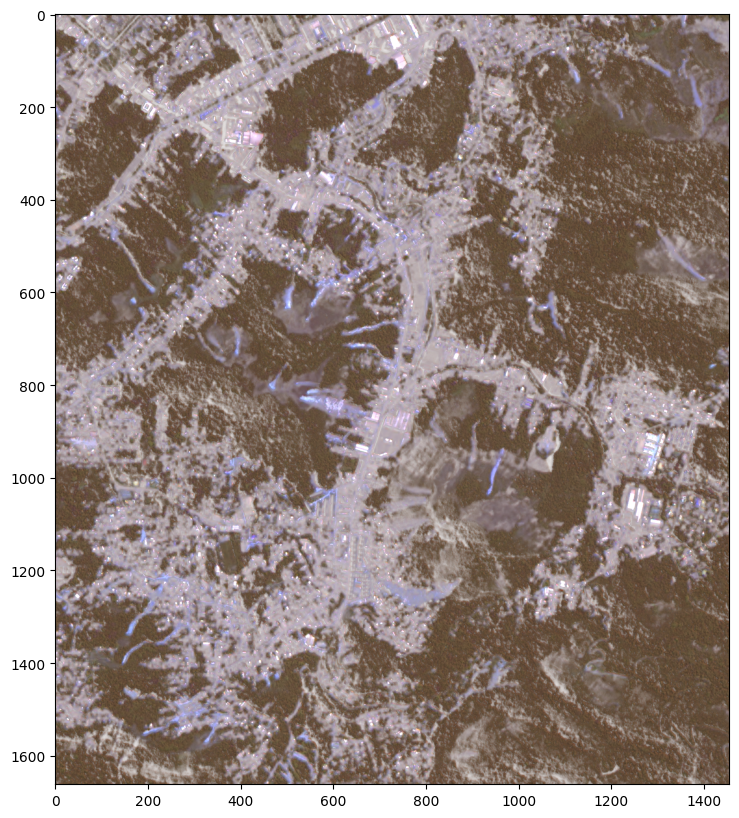

In [43]:
pansharp2022 = rasterio.open('/content/output2022_pansharpenedBGRNIR.tif').read()
# Stack RGB NIR
pansharp2022 = np.stack([pansharp2022[0],pansharp2022[1],
                  pansharp2022[2],pansharp2022[3]], axis=2)
# pansharp2022 = np.stack(pansharp2022, axis=2)
# pansharp2022 = np.dstack(pansharp2022)

print(pansharp2022.shape)

rgb2022_pansharp = pansharp2022 / pansharp2022.max()
plt.figure(figsize=(10, 10))
plt.imshow(rgb2022_pansharp*3)

In [44]:
dataset2022 = gdal.Open("/content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b0.tif", gdal.GA_ReadOnly)
GT2022 = dataset2022.GetGeoTransform()
print(GT2022)

(686714.0, 2.0, 0.0, 7509822.0, 0.0, -2.0)


##4.4: Mostrando Imagens 2022: RGB, RGNIR and Pansharpening

Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b1.tif
Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b2.tif
Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b3.tif
Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b1.tif
Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b2.tif
Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b3.tif
Opening file /content/recortes_20220304/cbers4a_wpm_20220304_198_141_l4_b4.tif


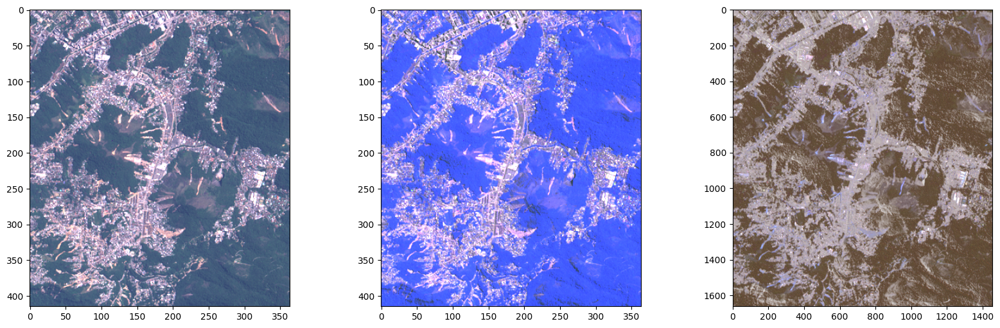

In [45]:
# load the image
img2022, image2022_ds = load_cbers_image('/content/recortes_20220304/',
                                   ['cbers4a_wpm_20220304_198_141_l4_b1',
                                    'cbers4a_wpm_20220304_198_141_l4_b2',
                                    'cbers4a_wpm_20220304_198_141_l4_b3'])
# create the RGB for the image
rgb2022 = np.stack([img2022['cbers4a_wpm_20220304_198_141_l4_b3'],
                img2022['cbers4a_wpm_20220304_198_141_l4_b2'],
                img2022['cbers4a_wpm_20220304_198_141_l4_b1']], axis=2)
rgb2022 = rgb2022 / rgb2022.max()

# load the image
img2022_bgrnir, image2022_ds = load_cbers_image('/content/recortes_20220304/',
                                   ['cbers4a_wpm_20220304_198_141_l4_b1',
                                    'cbers4a_wpm_20220304_198_141_l4_b2',
                                    'cbers4a_wpm_20220304_198_141_l4_b3',
                                    'cbers4a_wpm_20220304_198_141_l4_b4'])
# create the RGB NIR for the image
rg_nir2022 = np.stack([img2022_bgrnir['cbers4a_wpm_20220304_198_141_l4_b3'],
                    img2022_bgrnir['cbers4a_wpm_20220304_198_141_l4_b2'],
                    img2022_bgrnir['cbers4a_wpm_20220304_198_141_l4_b4']], axis=2)
rg_nir2022 = rg_nir2022 / rg_nir2022.max()

# load image
pansharp2022 = rasterio.open('/content/output2022_pansharpenedBGRNIR.tif').read()
pansharp2022 = np.dstack(pansharp2022)
pansharp2022 = pansharp2022 / pansharp2022.max()
# Plot the 3 images
fig, ax = plt.subplots(1, 3, figsize=(20, 6));
ax[0].imshow(rgb2022*3)
ax[1].imshow(rg_nir2022*3)
ax[2].imshow(pansharp2022*3);

In [46]:
print(rgb2022.shape, rg_nir2022.shape, pansharp2022.shape)  #(415, 363, 3) (415, 363, 4) (1662, 1452)<--

(415, 364, 3) (415, 364, 3) (1662, 1455, 4)


## 5: Corte de imagem pansharpening 2022 igual a 2021 para fazer concatenação

In [47]:
import random
import rasterio
from rasterio.windows import Window

with rasterio.open('/content/output2022_pansharpenedBGRNIR.tif') as src:

    # The size in pixels of your desired window
    xsize, ysize = 1452, 1662

    # Generate a random window origin (upper left) that ensures the window
    # doesn't go outside the image. i.e. origin can only be between
    # 0 and image width or height less the window width or height
    xmin, xmax = 0, src.width - xsize
    ymin, ymax = 0, src.height - ysize
    xoff, yoff = random.randint(xmin, xmax), random.randint(ymin, ymax)
    print(xoff, yoff)
    # Create a Window and calculate the transform from the source dataset
    window = Window(xoff, yoff, xsize, ysize)
    transform = src.window_transform(window)

    # Create a new cropped raster to write to
    profile = src.profile
    profile.update({
        'height': ysize,  #<--
        'width': xsize,   #<--
        'transform': af_transf2021_2022})

    with rasterio.open('output2022_pansharpenedBGRNIR_crop.tif', 'w', **profile) as dst:
        # Read the data from the window and write it to the output raster
        dst.write(src.read(window=window))


2 0


In [48]:
img2022_crop_array = rasterio.open('/content/output2022_pansharpenedBGRNIR_crop.tif').read()

# img2022_crop_array = np.resize(img2022_crop_array, (4, 1662,1452))
print(img2022_crop_array.shape, img_array.shape)


(4, 1662, 1452) (4, 1662, 1452)


In [49]:
dataset2022crop = gdal.Open("/content/output2022_pansharpenedBGRNIR_crop.tif", gdal.GA_ReadOnly)
GT2022crop = dataset2022crop.GetGeoTransform()
print(GT2022crop)  #(686716.0, 2.0, 0.0, 7509824.0, 0.0, -2.0) <- OK

(686716.0, 2.0, 0.0, 7509824.0, 0.0, -2.0)


In [50]:
# load image
pansharp2022crop = rasterio.open('/content/output2022_pansharpenedBGRNIR_crop.tif').read()
# Stack
pansharp2022crop_ = np.stack([pansharp2022crop[2],pansharp2022crop[1],
                              pansharp2022crop[0],pansharp2022crop[3]], axis=2)
pansharp2022crop_ = pansharp2022crop_ / pansharp2022crop_.max()

print(pansharp2022crop_.shape)

img = pansharp2022crop_ / pansharp2022crop_.max()

(1662, 1452, 4)


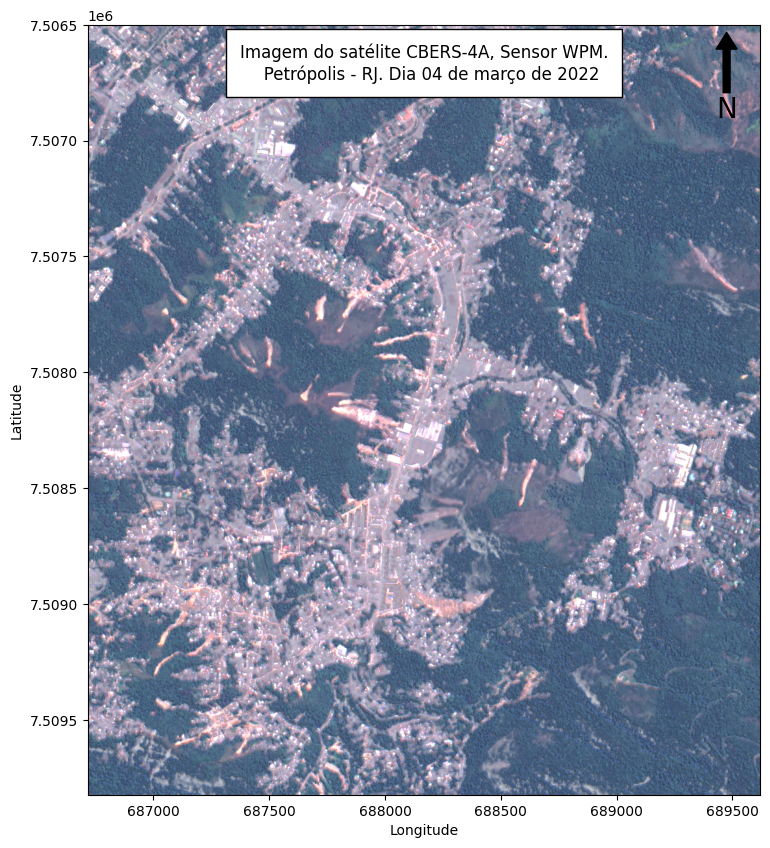

In [51]:
# Carregue a imagem raster com rasterio
path_to_raster = "/content/output2022_pansharpenedBGRNIR_crop.tif"
dataset = rasterio.open(path_to_raster)

# Ler os dados e a transformação do raster
data = dataset.read(1)  # Assumindo que é uma banda de dados
transform = dataset.transform

# Obter coordenadas de latitude e longitude para as bordas do raster
min_x, min_y = transform * (0, 0)
max_x, max_y = transform * (data.shape[1], data.shape[0])

# Plotar a imagem raster usando matplotlib
fig, ax = plt.subplots(1, figsize=(15, 10))

# Plotar o raster com imshow e integração com o plt
img = ax.imshow(img * 4, cmap="terrain", extent=[min_x, max_x, min_y, max_y])
# plt.colorbar(img, label="Escala")

# Personalizar rótulos e título do gráfico
plt.xlabel("Longitude")
plt.ylabel("Latitude")
# plt.title("Desastre em São Sebastião - SP")

# Inserir grids
# ax.grid(color='0.95', linestyle='dashed', linewidth=0.5, alpha=0.5)

# # Plotar box de informações

# Adicionar informações sobre a imagem
ax.text(0.5, 0.95,'Imagem do satélite CBERS-4A, Sensor WPM.\n   Petrópolis - RJ. Dia 04 de março de 2022',
        fontsize=12, transform=ax.transAxes, ha='center', va='center', bbox={'facecolor': 'white', 'pad': 10})

# Adicionar a orientação do norte
x, y, arrow_length = 0.95, 0.99, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y - arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=20,
            xycoords=ax.transAxes)

# Mostrar o gráfico na tela
plt.show()

##6: Concatenação de imagens pansharpening 2022 e 2021 (T2/T1)

(8, 1662, 1452)
(1662, 1452, 4)


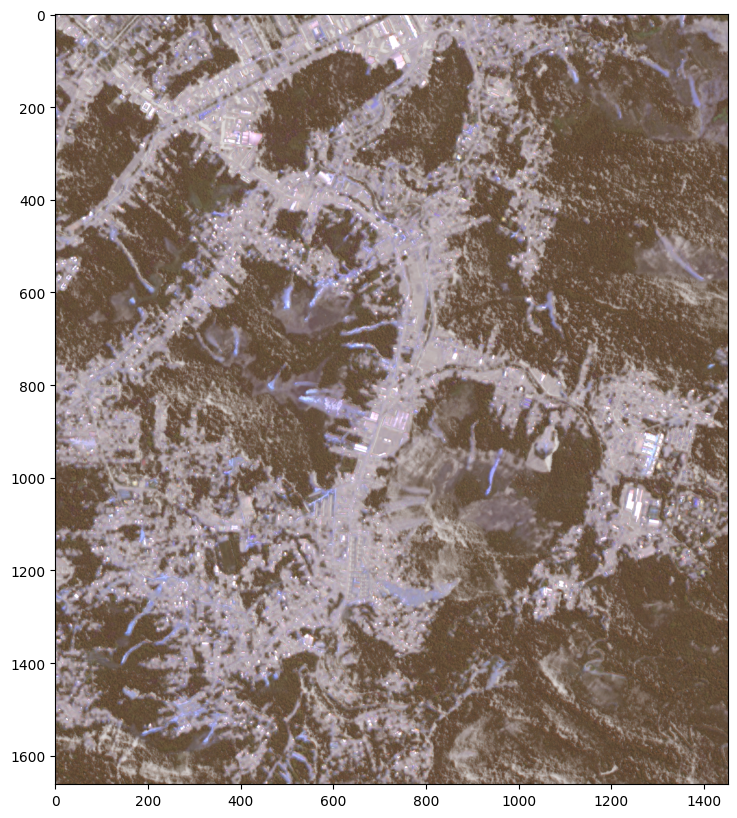

In [52]:
array_T1 = rasterio.open('/content/output_pansharpened2021BGRNIR.tif').read()
array_T2 = rasterio.open('/content/output2022_pansharpenedBGRNIR_crop.tif').read()

merge = np.concatenate((array_T2,array_T1), axis=0)  # axis 0 profundidade, 1 hor, 2 vert
print(merge.shape)

# plt.figure(figsize=(15,10))
# plt.gray()
# plt.imshow(merge[0,:,:]);

# Stack RGB NIR
merge_ = np.stack([merge[0],merge[1],
                  merge[2],merge[3]], axis=2)
# merge_ = np.stack(merge, axis=2)
# merge_ = np.dstack(merge)

print(merge_.shape)

rgb_t2_t1 = merge_ / merge_.max()
plt.figure(figsize=(15, 10))
plt.imshow(rgb_t2_t1*3)

In [53]:
#save image concatenated T2 and T1, to create patches
merge_.shape

(1662, 1452, 4)

In [54]:
# SAVE
with rasterio.open(
    'raster_out_concatenate_t2_t1.tif',
    'w',
    driver='GTiff',
    height=merge.shape[1],
    width=merge.shape[2],
    count=8,
    dtype=np.float32,
    crs=dst_crs,
    transform=af_transf2021_2022,
) as dest_file:
    dest_file.write(merge)
dest_file.close()

(1662, 1452, 4)


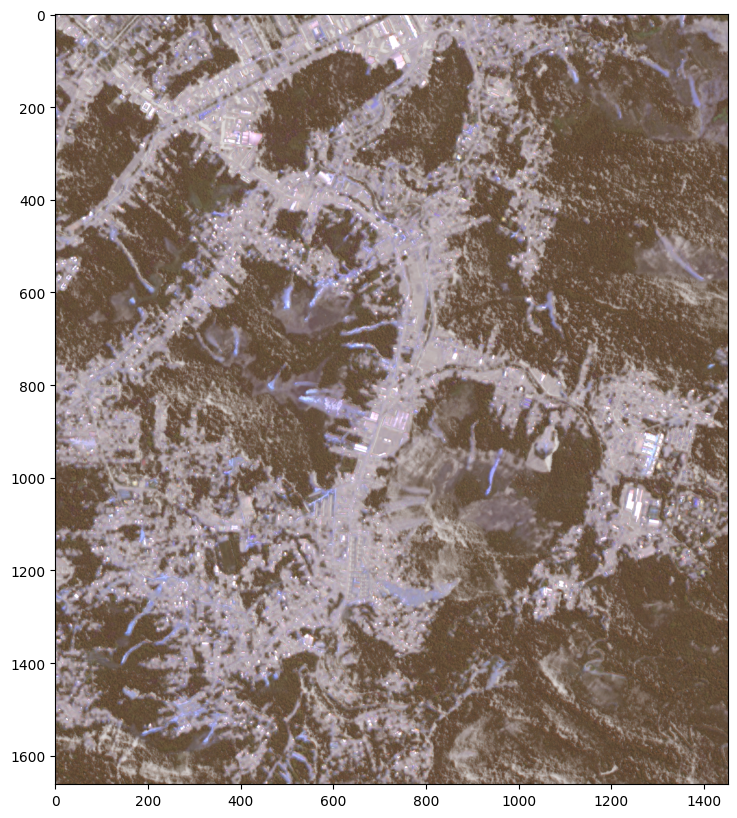

In [55]:
img_concat_array = rasterio.open('raster_out_concatenate_t2_t1.tif').read()
# plt.figure(figsize=(10, 10))
# plt.imshow(img_concat_array[0,:,:]);
# Stack RGB NIR - 8 channels
img_concat_array = np.stack([img_concat_array[0],img_concat_array[1],
                  img_concat_array[2],img_concat_array[3]], axis=2)
# img_concat_array = np.stack(img_concat_array, axis=2)
# img_concat_array = np.dstack(img_concat_array)

print(img_concat_array.shape)

concat_t2_t1 = img_concat_array / img_concat_array.max()
plt.figure(figsize=(15, 10))
plt.imshow(concat_t2_t1*3)

In [56]:
dataset_concatenate = gdal.Open("raster_out_concatenate_t2_t1.tif", gdal.GA_ReadOnly)
GT_concatenate = dataset_concatenate.GetGeoTransform()
print(GT_concatenate)

(686716.0, 2.0, 0.0, 7509824.0, 0.0, -2.0)


## 7: Criando patches 64 x 64 - systematic [2]

In [57]:
from osgeo import gdal
def systematic(tif_path, pixelX=None, pixelY=None, tamX=None,
                    tamY=None, sobras=False):
    """
    Função para criação de patches conforme parâmetros escolhidos pelo usuário.

    patch_generator(tif_path, pixelX=None, pixelY=None, tamX=None,
                    tamY=None, sobras = False)


    tif_path: Deve ser inserida uma string com o
    diretório onde a imagem raster está inserida.
    ex: '/content/crop_rapideye.tif'


    pixelX: Deve ser inserido um valor inteiro com
    a dimensão desejada para o eixo X do patche.
    (Dimensão X do Patche em pixels)
    ex: 300

    pixelY: Deve ser inserido um valor inteiro com
    a dimensão desejada para o eixo Y do patche.
    (Dimensão Y do Patche em pixels)
    ex: 300

    tamX: Deve ser inserido um valor inteiro, em metros, da
    dimensão desejada para o eixo X do patche.
    (Dimensão X do Patche em metros)
    ex: 1500

    tamY: Deve ser inserido um valor inteiro, em metros, da
    dimensão desejada para o eixo Y do patche
    (Dimensão Y do Patche em metros)
    ex: 1500

    sobras: Quando True irá gerar recortes das bordas, caso estas
    apresentem dimensões inferiores às inseridas pelo usuário


    Exemplo de aplicação:
    Por exemplo, inserindo os seguintes parâmetros...

    patch_generator('/content/crop_rapideye.tif', pixelX=300, pixelY=300)

    Serão criados patches de 300x300 pixels do raster
    crop_rapideye.tif
    """

    raster = gdal.Open(tif_path)

    # Coletando os dados do raster
    gt = raster.GetGeoTransform()
    name = raster.GetDescription()
    name = name.split('.')[-2]

    # Separando os valores da lista gt
    # Coleta da coordenada x do canto superior esquerdo
    img_xmin = gt[0]
    # Coleta da coordenada y do canto superior esquerdo
    img_ymax = gt[3]
    # Coleta da resolução da imagem
    res = gt[1]

    # Verificandoo tamanho da imagem nos eixos x e y.
    # n_pixelsx é o numero de pixels na dimensão x
    # n_pixelsy é o numero de pixels na dimensão y
    n_pixelsx = raster.RasterXSize
    n_pixelsy = raster.RasterYSize

    # img_xlen é tamanho da imagem em metros na dimensão x
    # img_ylen é tamanho da imagem em metros na dimensão y
    img_xlen = res * n_pixelsx
    img_ylen = res * n_pixelsy


    # Delimitando o tamanho do patch

    # Caso o usuário insera o valor das dimensões do patch em pixels
    if pixelX != None and pixelY != None:
        # tamanho do patch em metros
        patch_xlen = pixelX * res
        patch_ylen = pixelY * res
        print(f'Tamanho do patch: {patch_xlen}m x {patch_ylen}m')

    # Caso o usuário insira o valor das dimensões do patch em metros
    elif  tamX != None and tamY != None:
        patch_xlen = tamX
        patch_ylen = tamY

    # Verificação do número de patches por eixo (dimensão total da imagem no eixo x // dimensão do patch em metros no eixo x)
    xdiv = img_xlen//patch_xlen
    # Verificação do número de patches por eixo (dimensão total da imagem no eixo y // dimensão do patch em metros no eixo y)
    ydiv = img_ylen//patch_ylen

    # Verificação do número total de patches
    total_patches= xdiv*ydiv
    print(f'Número total de patches ({pixelX}m x{pixelY}m) criados: {total_patches}')

    # Testando se o tamanho da imagem é proporcional ao tamanho do patch nas duas dimensões
    # Verificando se o tamanho do patch inserido pelo usuário é múltiplo da dimensão da imagem tif

    if img_xlen % patch_xlen != 0 or img_ylen % patch_ylen !=0:
        print(f'O tamanho da imagem não é múltiplo do tamanho do patch.\n')

       # Se o valor na dimensão x ou y não for divisível pela dimensão total da imagem, será aumentado
       # um valor no número de sobras
        if sobras:
            if img_xlen % patch_xlen != 0:
                xdiv += 1
            elif img_ylen % patch_ylen !=0:
                ydiv += 1
                t_patches= xdiv*ydiv
            print(f'Número total de patches a serem criados (+ sobras): {total_patches} patches + {t_patches - total_patches} sobras')

    # img_xmin = coord_x canto superior esquerdo; img_ymax = coord_y canto superior esquerdo;

    # Criação de uma lista com as coordenadas em x, através de uma list comprehension
    # com step de 0 até o número total de patches no eixo x(xdiv)
    xsteps = [img_xmin + patch_xlen*i for i in range(int(xdiv)+1)]

    # Criação de uma lista com as coordenadas em y, através de uma list comprehension
    # com step de 0 até o número total de patches no eixo y(xdiv)
    ysteps = [img_ymax - patch_ylen*i for i in range(int(ydiv)+1)]

    # Pergunta para o usuário, verificando se ele realmente quer fazer o número de patches
    # Esse passo é para evitar a criação de números demasiados de patches devido erro de digitação
    resp = 'S'  # input(f'Dejesa criar {total_patches} patches? (S/N)')

    # Se a respota for Sim (S), os patches serão criados
    if resp.upper() == 'S':
        # id = número inicial do nome atribuído a cada um dos patches, começando pelo 1
        id = 1
        # Criação de dois for aninhado para a definição das coordenadas de recorte
        for i in range(int(xdiv)):
            for j in range(int(ydiv)):
                # Coordenadas x (max/min) para o recorte, extraídas da lista de coordenadas criadas anteriormente (xsteps)
                xmin = xsteps[i]
                xmax = xsteps[i+1]
                # Coordenadas y (max/min) para o recorte, extraídas da lista de coordenadas criadas anteriormente (ysteps)
                ymax = ysteps[j]
                ymin = ysteps[j+1]

                gdal.Warp(name + '_' + 'p' + str(id) +'.tif', raster, outputBounds = (xmin, ymin, xmax, ymax), dstNodata = -9999)
                id += 1
        print(f'>> {total_patches} patches criados!')

    # Caso a resposta seja não (n), o programa não irá criar os patches
    elif resp.upper() == 'N':
        print('Programa finalizado, você optou por não criar nenhum patch.')
        print('-' * 100)

In [58]:
!rm -rf patches_petropolis

In [59]:
# CRIA DIRETÓRIO E MOVE PATCHES PARA LÁ - CENAS
!mkdir patches_petropolis
!mkdir patches_petropolis/cenas

systematic('/content/raster_out_concatenate_t2_t1.tif', pixelX=64, pixelY=64, sobras=False)

# CRIA DIRETÓRIO E MOVE PATCHES PARA LÁ
!mv /content/raster_out_concatenate_t2_t1_p*.tif /content/patches_petropolis/cenas

Tamanho do patch: 128.0m x 128.0m
Número total de patches (64m x64m) criados: 550.0
O tamanho da imagem não é múltiplo do tamanho do patch.

>> 550.0 patches criados!


## 8: Após a rotulação de deslizamentos de terra no QGIS, criar patches de rótulos 64 x 64

In [60]:
!pip install --upgrade --no-cache-dir gdown

  Attempting uninstall: gdown
    Found existing installation: gdown 4.6.6
    Uninstalling gdown-4.6.6:
      Successfully uninstalled gdown-4.6.6


In [61]:
!gdown 1kUlQxvQM2mYeSLBV73xaCmuD-VzIaltU

Downloading...
From: https://drive.google.com/uc?id=1kUlQxvQM2mYeSLBV73xaCmuD-VzIaltU
To: /content/CBERS_4A_WPM_20220304_198_141_L4_p_cut_class.tif
100% 9.68M/9.68M [00:00<00:00, 50.3MB/s]


(1, 1663, 1453)

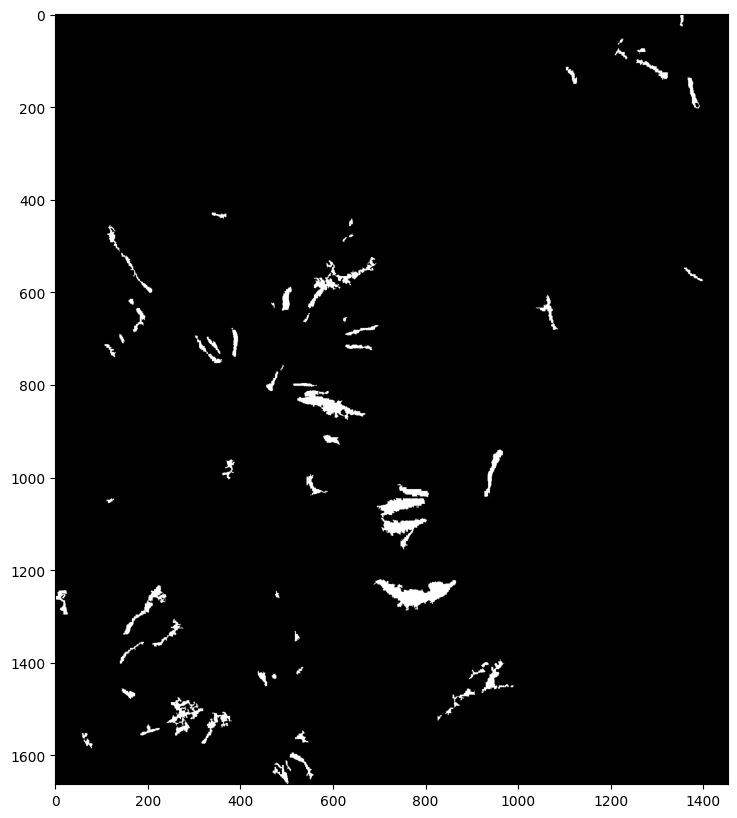

In [62]:
img_labels = rasterio.open('/content/CBERS_4A_WPM_20220304_198_141_L4_p_cut_class.tif').read()
plt.figure(figsize=(10, 10))
plt.imshow(img_labels[0,:,:], cmap='gray');
img_labels.shape

In [63]:
import random
import rasterio
from rasterio.windows import Window

with rasterio.open('/content/CBERS_4A_WPM_20220304_198_141_L4_p_cut_class.tif') as src:

    # The size in pixels of your desired window
    xsize, ysize = 1452, 1662

    # Generate a random window origin (upper left) that ensures the window
    # doesn't go outside the image. i.e. origin can only be between
    # 0 and image width or height less the window width or height
    xmin, xmax = 0, src.width - xsize
    ymin, ymax = 0, src.height - ysize
    xoff, yoff = random.randint(xmin, xmax), random.randint(ymin, ymax)
    print(xoff, yoff)
    # Create a Window and calculate the transform from the source dataset
    window = Window(xoff, yoff, xsize, ysize)
    transform = src.window_transform(window)

    # Create a new cropped raster to write to
    profile = src.profile
    profile.update({
        'height': ysize,  #<--
        'width': xsize,   #<--
        "count": 1,
        "dtype": np.float64,
        "crs": dst_crs,
        "transform": af_transf2021_2022
        })

    with rasterio.open('CBERS_4A_WPM_20220304_198_141_L4_p_cut_class_crop.tif', 'w', **profile) as dst:
        # Read the data from the window and write it to the output raster
        dst.write(src.read(window=window))


0 0


In [64]:
dataset_labels = gdal.Open("CBERS_4A_WPM_20220304_198_141_L4_p_cut_class_crop.tif", gdal.GA_ReadOnly)
GT_labels = dataset_labels.GetGeoTransform()
print(GT_labels)   #(686716.0, 2.0, 0.0, 7509824.0, 0.0, -2.0) <-  ok

(686716.0, 2.0, 0.0, 7509824.0, 0.0, -2.0)


(1, 1662, 1452)

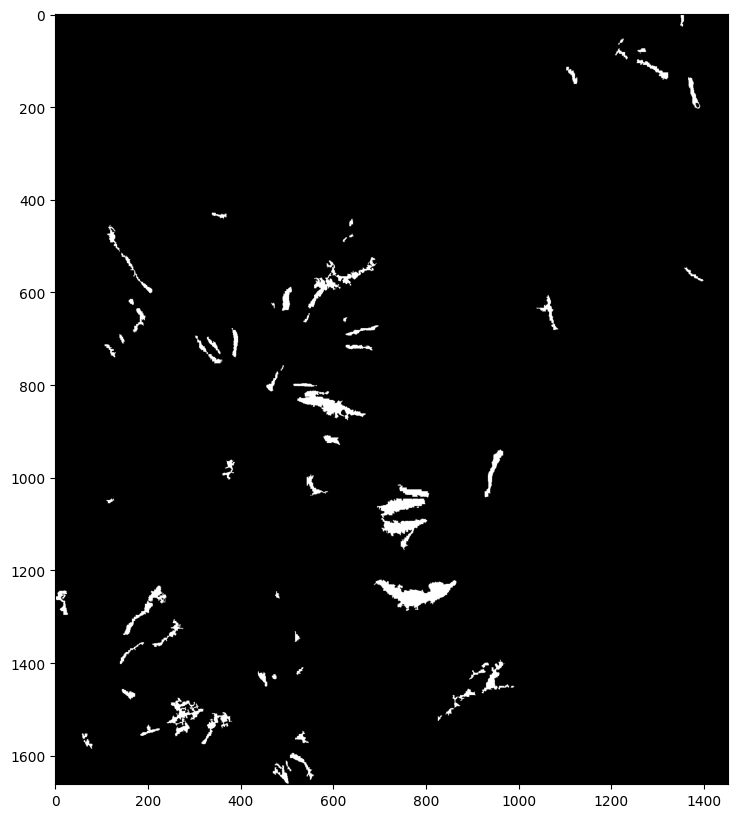

In [65]:
img_labels = rasterio.open('CBERS_4A_WPM_20220304_198_141_L4_p_cut_class_crop.tif').read()
plt.figure(figsize=(10, 10))
plt.imshow(img_labels[0,:,:], cmap='gray');
img_labels.shape

In [66]:
systematic('/content/CBERS_4A_WPM_20220304_198_141_L4_p_cut_class_crop.tif', pixelX=64, pixelY=64, sobras=False)

# CRIA DIRETÓRIO E MOVE PATCHES PARA LÁ - CLASSES
!mkdir patches_petropolis/classes
!mv /content/CBERS_4A_WPM_20220304_198_141_L4_p_cut_class_crop_p*.tif /content/patches_petropolis/classes

Tamanho do patch: 128.0m x 128.0m
Número total de patches (64m x64m) criados: 550.0
O tamanho da imagem não é múltiplo do tamanho do patch.

>> 550.0 patches criados!


## 9: Tensorflow Keras

## Introdução

### Modelo de Segmentação Semântica CNN utilizando Keras, para classificação pixel a pixel de patches de imagens bitempotais de deslizamentos de terra do desastre ocorrido em 15 de Fevereiro de 2022 na região de Petrópolis, Rio de Janeiro. A ideia desse projeto foi utilizar a  arquitetura de Segmentação Semântica U-net, usada no Hackathon WorCAP 2022 para classes do Cerrado, organizado pelo Instituto Nacional de Pesquisa Espacial (INPE) [3], aplicando a resolução para o domínio Deslizamento de Terra.
<hr style="border:1px solid #7D26CD">

In [67]:
import os
import glob
# Dados
import imgaug as ia
import imgaug.augmenters as iaa
import random
import PIL
from PIL import Image
from PIL import ImageOps

# Leitura das imagens
from skimage import io

import numpy as np
import time

import pandas as pd
from tensorflow.keras.preprocessing import image

# Machine Learning
import tensorflow as tf
from tensorflow import keras
from sklearn.metrics import f1_score, classification_report, accuracy_score, confusion_matrix

# Gráficos
import matplotlib.pyplot as plt
import random
from imageio import mimread

tf.__version__

'2.14.0'

In [68]:
seed = 42
np.random.seed = seed
random.seed = seed
tf.random.set_seed(42)

## 10: Teste de generalização de U-Net para Petrópolis

## 10.1: Configurações iniciais



In [69]:
cbers_ = ['/content/patches_petropolis/cenas',
          '/content/patches_petropolis/classes']

## 10.2: Leitura e visualização dos dados

In [70]:
# Função para leitura dos files
def read_image(image_path, mask=False):
    # Recebe os caminhos dos files
    img = io.imread(image_path)

    # Se for label a variável img receberá ela mesma
    if mask:
        # A imagem recebe apenas imagem
        img = img
    # Caso contrário,
    else:
        # se for patch o valores dos pixels é divido por 255
        img = img/255
    # A função retorna a imagem
    return img

In [71]:
# Organização da lista de rasters
# Lista: armazenará os paths de cada patch
org_path_pacth1 = []

# Loop: Acessa o diretório [0] para ler o paths
for raster in glob.iglob(cbers_[0]+'/*.tif'):
    # Armazena o paths na lista
    org_path_pacth1.append(raster)
# Ordena os strings dos paths
org_path_pacth1.sort()

# Organização da lista de labels
#Lista: armazenará os paths de cada patch
org_path_label1 = []
# Loop: Acessa o diretório [1] para ler o paths
for raster in glob.iglob(cbers_[1]+'/*.tif'):
    # Armazena o paths na lista
    org_path_label1.append(raster)
# Ordena os strings dos paths
org_path_label1.sort()

In [72]:
# Leitura e armazenamentos dos raster
# Lista: Armazenará as imagens
patche = []
# Loop: acessa cada path
for i in org_path_pacth1:
    # Leitura: chama a função de leitura
    imagem = read_image(i)
    # Armazena patches na lista
    patche.append(imagem)


In [73]:
# Leitura e armazenamentos dos labels
# Lista: Armazenará as imagens
label = []
# Loop: acessa cada path
for i in org_path_label1:
    # Leitura: chama a função de leitura
    mask = read_image(i, mask=True)

    new_mask = np.where(mask > 0, mask, 0)

    # Armazena labels na lista
    label.append(new_mask)

In [74]:
# Transforma em array
patche_cena = np.array(patche)
patche_classe = np.array(label)

### 10.3: Dados para Teste

In [75]:
patche_cena.shape, patche_classe.shape

((550, 64, 64, 8), (550, 64, 64))

In [76]:
patche_ = patche_cena[:,:,:,0]
patche_.shape

(550, 64, 64)

In [77]:
# # Embaralha dados - patch, label (x,y)
# from sklearn.utils import shuffle
# def embaralha(x, y, seed=42):
#   x, y = shuffle(x, y, random_state=seed)
#   return x, y

# patch, label = embaralha(patch, label)

### 10.4: Visualizar patches das cenas e classes

In [78]:
# variáveis para contar deslizamentos e não deslizamentos
landslide = 0
no_landslide = 0
# Listas de deslizamentos e não-deslizamentos dataset original
list_patches_ls_o = []
list_patches_n_ls_o = []
# laço de contagem
for i in range(len(patche_classe)):  #Refazer amostragem de patche_classes no QGIS?

  # print(patche_classe[i])
  # Verifica valor diferente de -1 na matriz para deslizamento
  if np.any(patche_classe[i] >= 1):
    landslide += 1
    list_patches_ls_o.append(i)
  else:
    no_landslide += 1
    list_patches_n_ls_o.append(i)
#quantidade de deslizamentos e não deslizamentos
print(f'Números de deslizamentos: {landslide}; Número de não-deslizamentos: {no_landslide}.')
print(f'Listas: \nDeslizamentos: {list_patches_ls_o};\nNão-deslizamentos: {list_patches_n_ls_o}.')

Números de deslizamentos: 112; Número de não-deslizamentos: 438.
Listas: 
Deslizamentos: [2, 14, 15, 25, 28, 29, 37, 41, 42, 47, 55, 57, 69, 70, 74, 82, 95, 96, 97, 98, 106, 109, 112, 113, 122, 123, 124, 125, 127, 128, 130, 131, 136, 137, 138, 140, 148, 149, 150, 151, 152, 153, 154, 155, 157, 159, 167, 175, 176, 177, 180, 181, 183, 186, 187, 190, 213, 214, 215, 216, 217, 218, 242, 243, 246, 247, 250, 256, 273, 276, 277, 295, 296, 297, 300, 303, 304, 323, 330, 331, 346, 347, 356, 364, 365, 392, 418, 419, 445, 448, 449, 474, 476, 477, 483, 484, 504, 505, 507, 508, 509, 519, 520, 521, 522, 523, 534, 535, 545, 546, 547, 549];
Não-deslizamentos: [0, 1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 16, 17, 18, 19, 20, 21, 22, 23, 24, 26, 27, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 43, 44, 45, 46, 48, 49, 50, 51, 52, 53, 54, 56, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 71, 72, 73, 75, 76, 77, 78, 79, 80, 81, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 99, 100, 101, 102, 103, 104, 105, 107, 108,

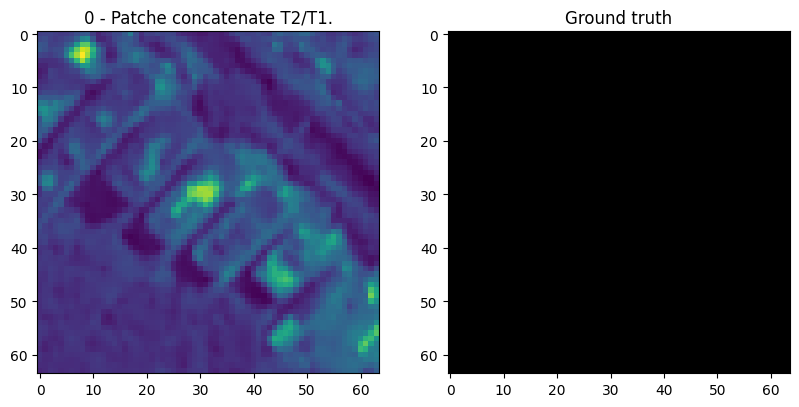

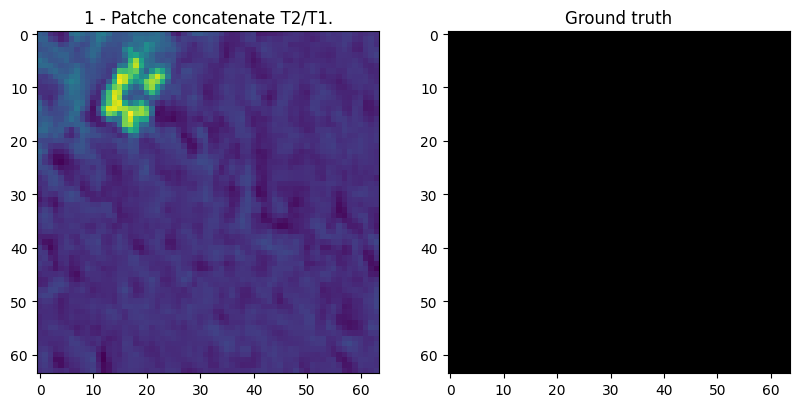

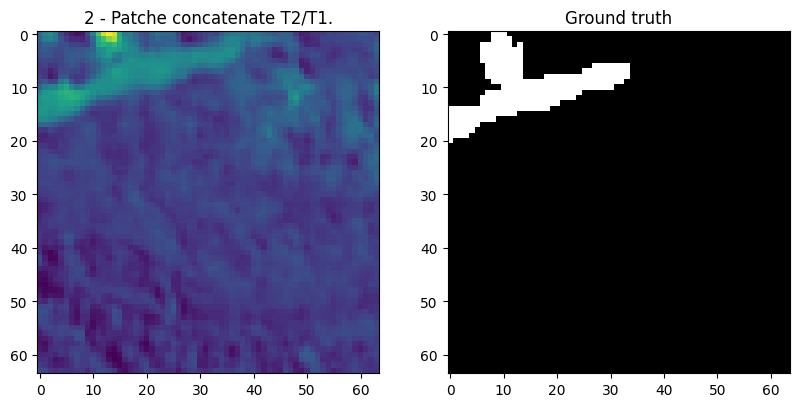

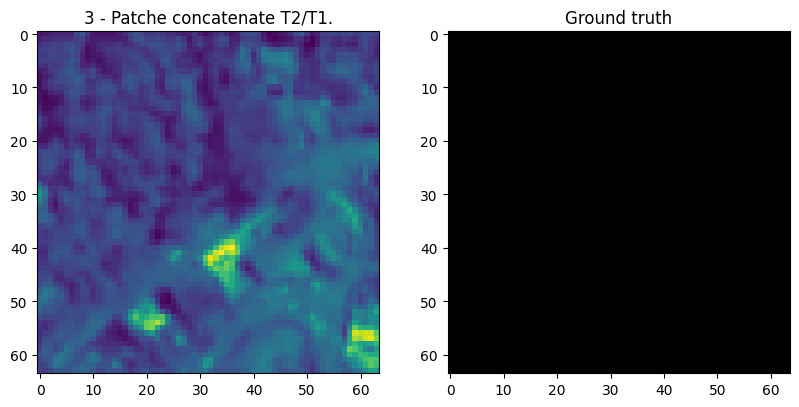

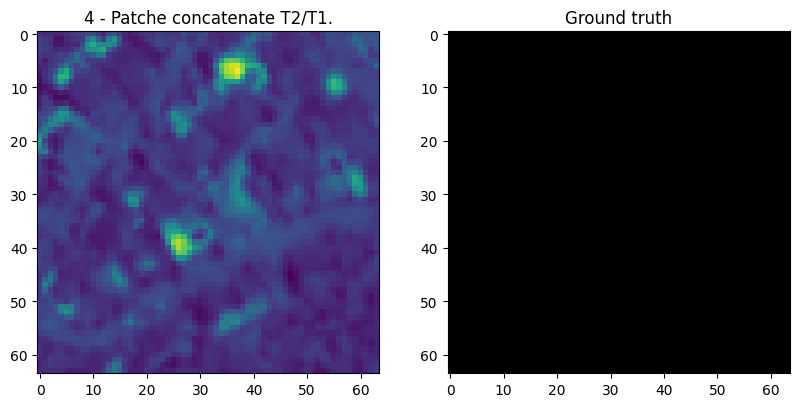

...

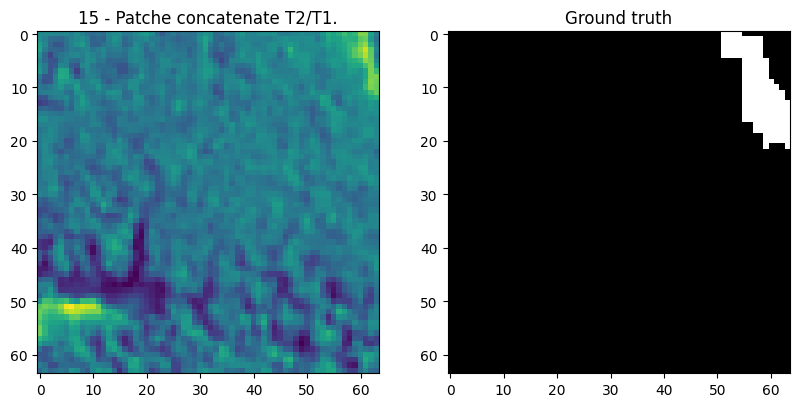

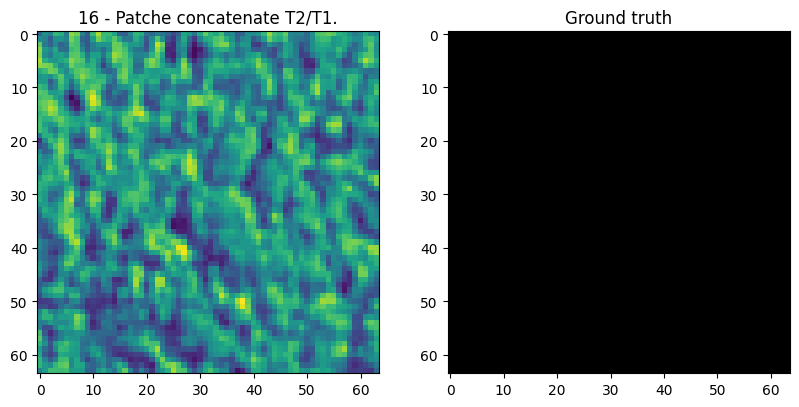

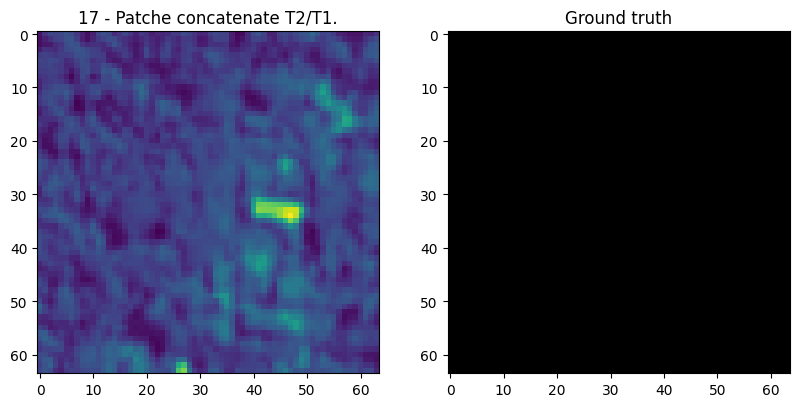

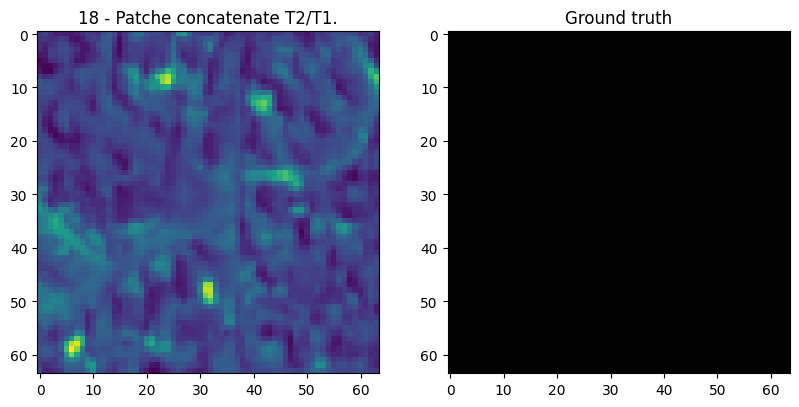

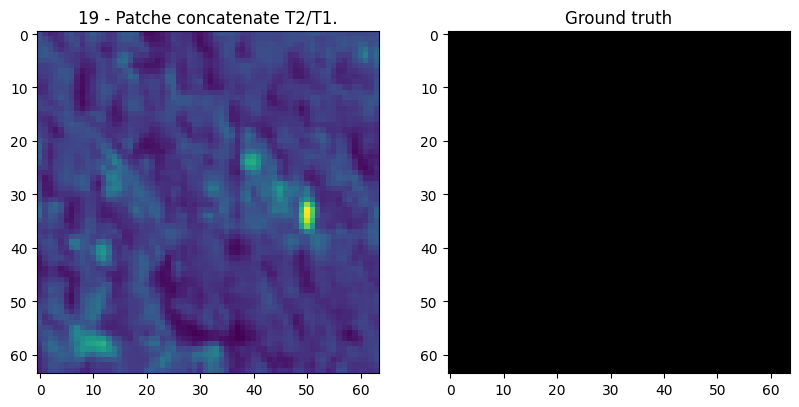

In [79]:
# problema para mostrar classes com img do cod. shape2raster.
for index in range(20): #len(patche_)
  # Faz Stack do label na intenção de aumentar a quantidade canais de 1 para 3
  # yt = np.dstack((label[index],label[index],label[index]))

  # Visualiza: Raster do subconjunto de treinamento
  plt.figure(figsize=(15, 10))
  plt.subplot(131)
  plt.imshow(patche_[index])
  plt.title(f'{index} - Patche concatenate T2/T1.')

  # Visualiza: Label
  plt.subplot(132)
  plt.imshow(patche_classe[index], cmap='gray')
  # plt.title('Figura 3 - Label.')
  # m1 = image.array_to_img(yt)
  # m1 = PIL.ImageOps.autocontrast(m1)
  # plt.imshow(m1)
  plt.title('Ground truth')
  plt.show()

# yt.shap

## 10.6: Download modelo U-Net

In [84]:
# !gdown 12rn6cYlsgpzEtkj9Kxh8KARoS9DDhOBU
# !gdown 1XNF8TzlsOb8DeZRzGJK0TKlY8tx1PXMs  # unetpp
!gdown 1HszbsR2evbASkZgaNpgJFC9c3vl5RVAx  #<-

Downloading...
From: https://drive.google.com/uc?id=1HszbsR2evbASkZgaNpgJFC9c3vl5RVAx
To: /content/modelo_ssebastiao_aug_treina_8e.h5
100% 92.6M/92.6M [00:01<00:00, 71.9MB/s]


In [81]:
# Função IoU para 8 canais
def iou_8_channels(y_true, y_pred):
    y_pred = tf.argmax(y_pred, axis=-1)
    y_true = tf.cast(y_true, tf.int64)

    intersection = tf.reduce_sum(tf.cast(tf.logical_and(tf.equal(y_true, 1), tf.equal(y_pred, 1)), tf.float32))
    union = tf.reduce_sum(tf.cast(tf.logical_or(tf.equal(y_true, 1), tf.equal(y_pred, 1)), tf.float32))

    return intersection / (union + tf.keras.backend.epsilon())

tf.keras.utils.get_custom_objects().update({"iou_8_channels": iou_8_channels})

In [85]:
from tensorflow.keras.models import load_model

# Carregar o modelo fornecendo o argumento custom_objects
model = load_model('/content/modelo_ssebastiao_aug_treina_8e.h5')

In [86]:
model.load_weights('/content/modelo_ssebastiao_aug_treina_8e.h5')

## 10.7: Teste de generalização

In [87]:
# Predicão
y_pred = model.predict(patche_cena)

18/18 [==============================] - 8s 59ms/step


In [88]:
# Retorna os valores máximos dos índices no eixo 3
y_pred_argmax = np.argmax(y_pred, axis=3)

In [89]:
# Altera o tipo de dado para int16
y_pred_argmax = y_pred_argmax.astype('int16')

In [90]:
y_pred_argmax.shape

(550, 64, 64)

In [91]:
# variáveis para contar deslizamentos e não deslizamentos
landslide_pred = 0
no_landslide_pred = 0
# Listas deslizamentos e não-deslizamentos preditos
list_patches_ls_p = []
list_patches_n_ls_p = []
# laço de contagem
for i in range(len(y_pred_argmax)):

  classe = y_pred_argmax[i]
  # print(classe)
  # Verifica valor diferente de 0 na matriz para deslizamento
  if np.any(classe != 0):
    landslide_pred += 1
    list_patches_ls_p.append(i)
  else:
    no_landslide_pred += 1
    list_patches_n_ls_p.append(i)

#quantidade de deslizamentos e não deslizamentos
print(f'Dataset original \nNúmeros de deslizamentos: {landslide}; Número de não-deslizamentos: {no_landslide}.')
print(f'Preditos \nNúmeros de deslizamentos: {landslide_pred}; Número de não-deslizamentos: {no_landslide_pred}.')

print(f'Lista dataset original \nDeslizamento: {list_patches_ls_o}')
print(f'Lista de preditos \nDeslizamento: {list_patches_ls_p}\n')
interseccao_ls = list(set(list_patches_ls_o) & set(list_patches_ls_p))
print('intersecção dos conjunto original com o predito para deslizamentos:\n', np.sort(interseccao_ls))

print(f'\nLista dataset original \nNão-deslizamentos: {list_patches_n_ls_o}')
print(f'Lista de preditos \nNão-deslizamentos: {list_patches_n_ls_p}\n')
interseccao_no_ls = list(set(list_patches_n_ls_o) & set(list_patches_n_ls_p))
print('intersecção do conjunto original com o predito para não-deslizamentos:\n', np.sort(interseccao_no_ls))

print('\nQuantidade de intersecção de deslizamentos: ', len(interseccao_ls))
print('\nQuantidade de intersecção de não-deslizamentos: ', len(interseccao_no_ls))

Dataset original 
Números de deslizamentos: 112; Número de não-deslizamentos: 438.
Preditos 
Números de deslizamentos: 73; Número de não-deslizamentos: 477.
Lista dataset original 
Deslizamento: [2, 14, 15, 25, 28, 29, 37, 41, 42, 47, 55, 57, 69, 70, 74, 82, 95, 96, 97, 98, 106, 109, 112, 113, 122, 123, 124, 125, 127, 128, 130, 131, 136, 137, 138, 140, 148, 149, 150, 151, 152, 153, 154, 155, 157, 159, 167, 175, 176, 177, 180, 181, 183, 186, 187, 190, 213, 214, 215, 216, 217, 218, 242, 243, 246, 247, 250, 256, 273, 276, 277, 295, 296, 297, 300, 303, 304, 323, 330, 331, 346, 347, 356, 364, 365, 392, 418, 419, 445, 448, 449, 474, 476, 477, 483, 484, 504, 505, 507, 508, 509, 519, 520, 521, 522, 523, 534, 535, 545, 546, 547, 549]
Lista de preditos 
Deslizamento: [2, 11, 13, 37, 42, 57, 70, 74, 76, 95, 98, 106, 109, 112, 123, 124, 127, 128, 130, 131, 138, 140, 144, 149, 150, 151, 152, 153, 154, 155, 157, 159, 176, 177, 180, 181, 183, 207, 214, 246, 256, 273, 276, 295, 296, 297, 300, 303, 304

In [92]:
"""
porcentagem de acertos de deslizamentos
111 ------ 1 (deslizamentos verdadeiros)
64  ------ x (acertos da intercessão)
"""
x = len(interseccao_ls)/landslide;
x

0.5625

In [93]:
patche_cena_ = patche_cena[:,:,:,0]

patche_classe.shape,patche_cena.shape,patche_cena_.shape

((550, 64, 64), (550, 64, 64, 8), (550, 64, 64))

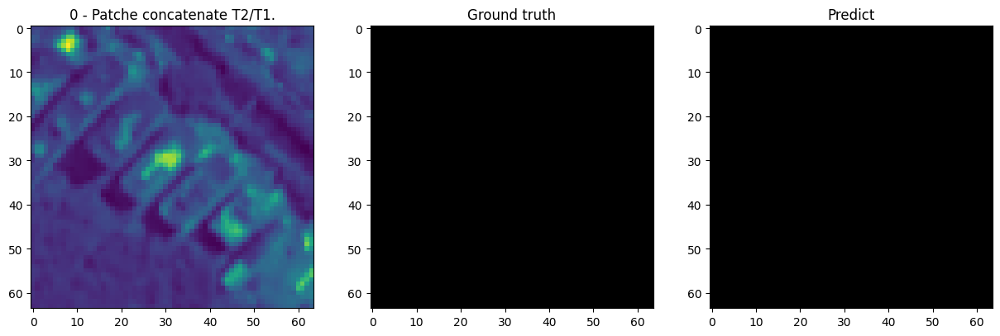

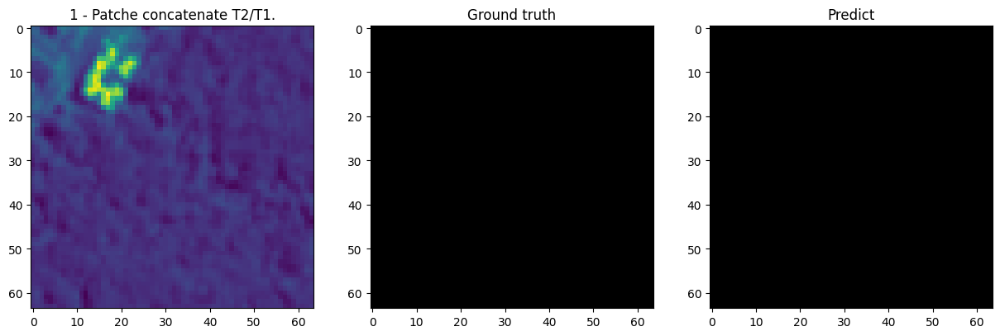

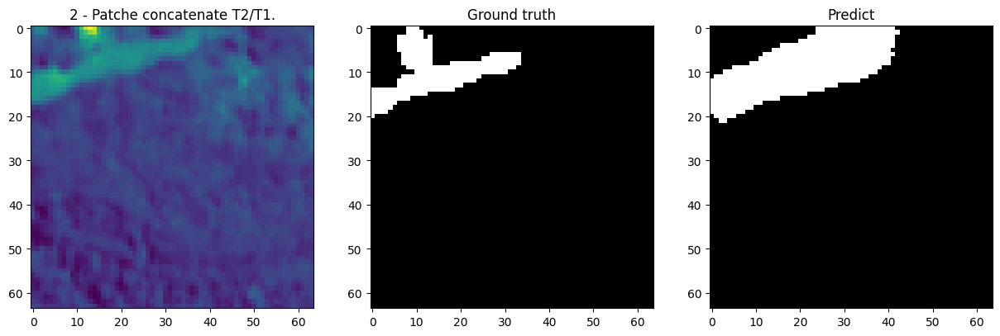

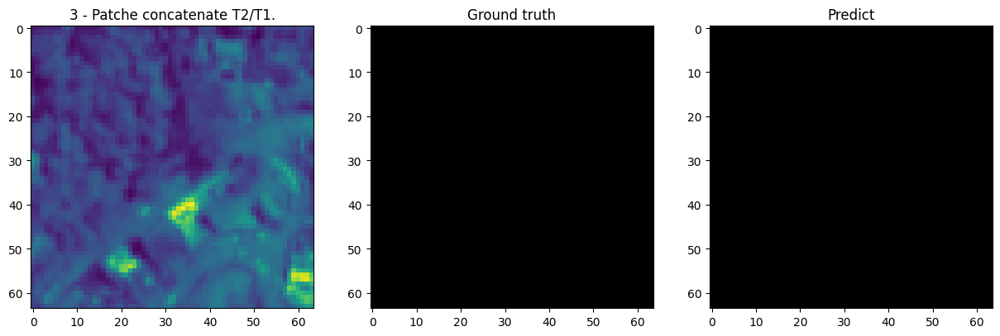

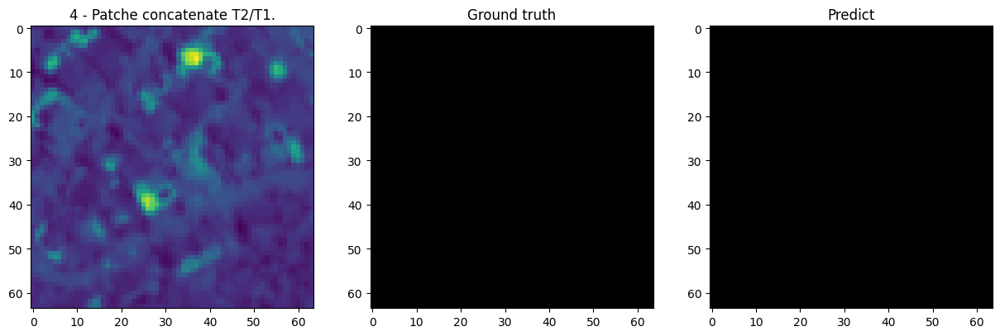

...

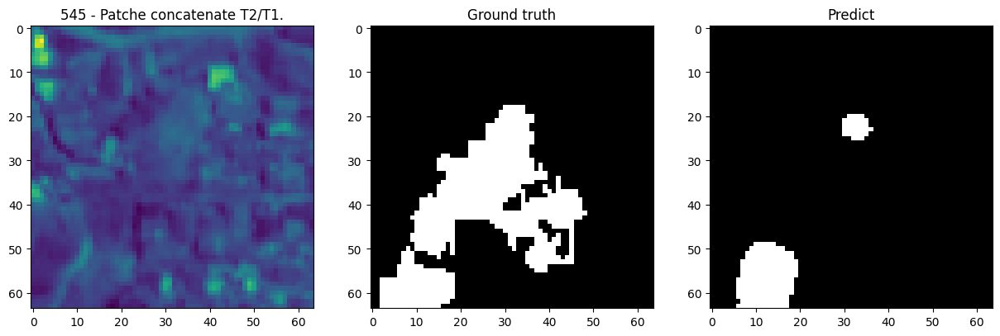

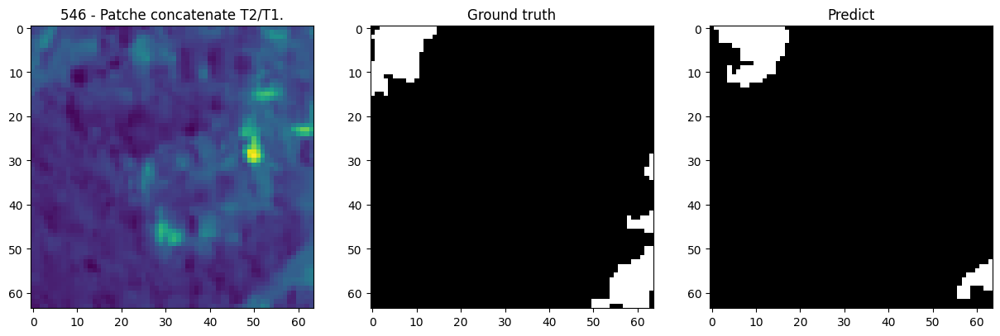

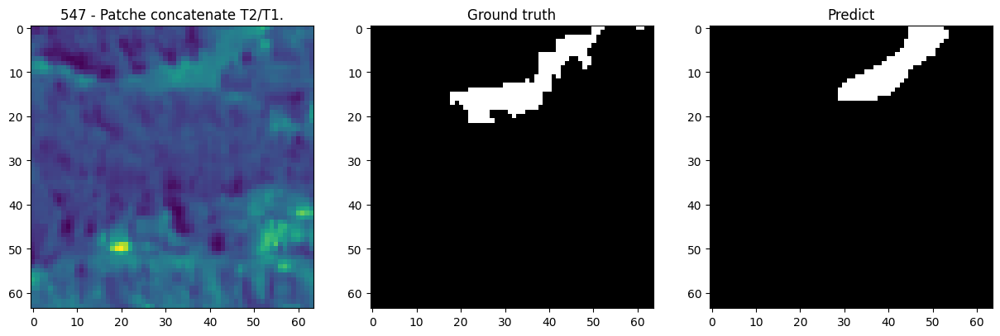

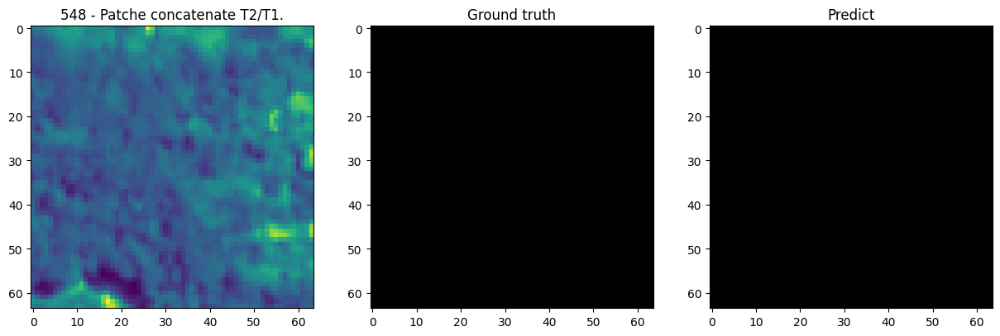

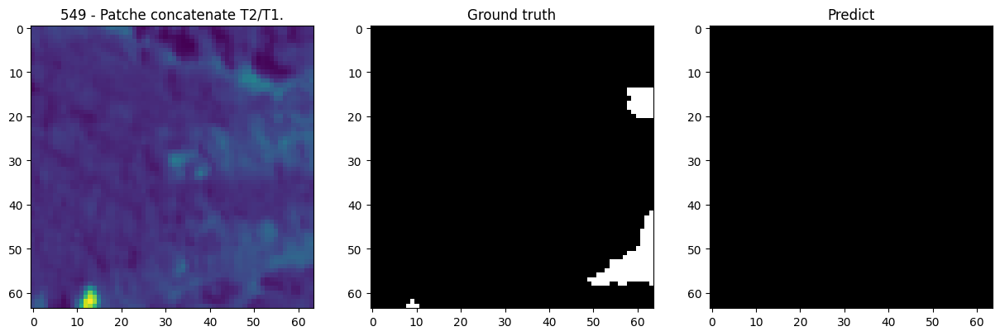

In [94]:
# Vizualização dos patches e predito
for index in range(len(patche_cena_)): #len(patche_cena_)
    # Faz Stack do label na intenção de aumentar a quantidade canais de 1 para 3
    # yt = np.dstack((label[index],label[index],label[index]))
    # Faz Stack do y_pred_argmax
    yp = np.dstack((y_pred_argmax[index],y_pred_argmax[index],y_pred_argmax[index]))

    # Visualiza: Raster do subconjunto de treinamento
    plt.figure(figsize=(15, 10))
    plt.subplot(131)
    plt.imshow(patche_cena_[index])
    plt.title(f'{index} - Patche concatenate T2/T1.')

    # Visualiza: Label
    plt.subplot(132)
    plt.imshow(patche_classe[index], cmap='gray')
    # plt.title('Figura 3 - Label.')
    # m1 = image.array_to_img(yt)
    # m1 = PIL.ImageOps.autocontrast(m1)
    # plt.imshow(m1)
    plt.title('Ground truth')

    # Visualiza: subconjunto classificado
    plt.subplot(133)
    m1 = image.array_to_img(yp)
    m1 = PIL.ImageOps.autocontrast(m1)
    plt.imshow(m1)
    plt.title('Predict')
    plt.show();

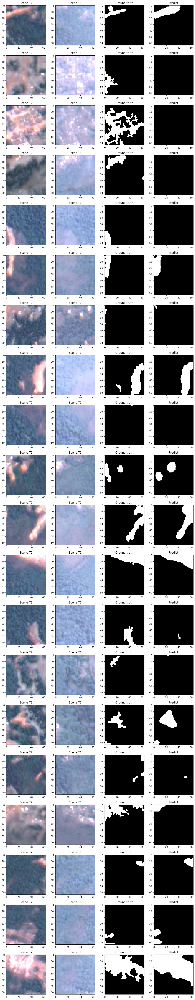

In [95]:
# visualização das imagens de teste
def visualize_images(num_rows, random_indices):
    fig, axes = plt.subplots(num_rows, 4, figsize=(12, 3*num_rows))

    for i in range(num_rows):
        # Stack BGR NIR to RGB NIR - 8 channels -> 4 channels
        image_rgb_t1 = np.stack([patche_cena[random_indices[i], :, :, 6], patche_cena[random_indices[i], :, :, 5],
                                         patche_cena[random_indices[i], :, :, 4], patche_cena[random_indices[i], :, :, 7]], axis=2)
        image_rgb_t2 = np.stack([patche_cena[random_indices[i], :, :, 2], patche_cena[random_indices[i], :, :, 1],
                                        patche_cena[random_indices[i], :, :, 0], patche_cena[random_indices[i], :, :, 3]], axis=2)

        image_rgb_t1 = image_rgb_t1 / image_rgb_t1.max()
        image_rgb_t2 = image_rgb_t2 / image_rgb_t2.max()

        # image_rgb_t1 = patche_cena[random_indices[i], :, :, 4:]
        # image_rgb_t2 = patche_cena[random_indices[i], :, :, :4]

        ground_truth = patche_classe[random_indices[i]]
        predict = y_pred_argmax[random_indices[i]]

         # Cena T2
        axes[i, 0].imshow(image_rgb_t2*2)
        axes[i, 0].set_title('Scene T2')

        # Cena T1
        axes[i, 1].imshow(image_rgb_t1*2)
        axes[i, 1].set_title('Scene T1')

        # Ground truth
        axes[i, 2].imshow(ground_truth, cmap='gray')
        axes[i, 2].set_title('Ground truth')

        # Predict
        axes[i, 3].imshow(predict, cmap='gray')
        axes[i, 3].set_title('Predict')

    plt.tight_layout()
    plt.show()

# Escolha aleatoriamente algumas imagens para visualizar
num_samples = 20
# random_indices = np.random.randint(0, patche_cena.shape[0], num_samples)

#bom ... ,157,159,180,181,183,246,273,296,296,304,347,448,449,505,507,508
random_indices = [2,25,28,29,69,70,74,95,96,109,
                  124,128,130,138,140,149,151,153,154,155] #error: 242,243

# Visualizar as cenas e as classes lado a lado
visualize_images(num_samples, random_indices)

##10.8: F1-Score e Acurácia

In [96]:
from sklearn.metrics import f1_score, classification_report, accuracy_score, confusion_matrix

# Teste separando patchs e labels do dataset
# F1-Score:
f1 = f1_score(list(patche_classe.flatten()), list(y_pred_argmax.flatten()), average='weighted')
print("F1-Score: ", f1)

# Accuracy:
acc = accuracy_score(list(patche_classe.flatten()), list(y_pred_argmax.flatten()))
print("Accuracy: ", acc)

F1-Score:  0.983272748461687
Accuracy:  0.9855126953125


## 10: Métrica IoU

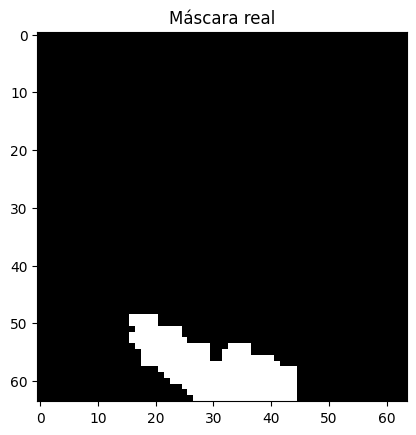

In [97]:
id_img_teste = 521
img_teste = patche_cena[id_img_teste]
ground_truth = patche_classe[id_img_teste]
plt.imshow(np.squeeze(ground_truth), cmap='gray')
plt.title('Máscara real');

In [98]:
from tensorflow.keras.metrics import MeanIoU
iou_resultado = MeanIoU(num_classes = 2)

In [99]:
img_teste.shape

(64, 64, 8)

In [100]:
# test_img_input = np.expand_dims(img_teste, 0)
# test_img_input.shape
img_test = img_teste.reshape(1, 64, 64, 8)

In [101]:
predictions = model.predict(img_test)

1/1 [==============================] - 0s 489ms/step


In [102]:
predictions = tf.argmax(predictions, axis=-1)

In [103]:
ground_truth = ground_truth.reshape(1, 64, 64, 1)

In [104]:
ground_truth = tf.cast(ground_truth, tf.int64)

In [105]:
iou_resultado.update_state(ground_truth, predictions)
iou = iou_resultado.result()

In [106]:
ground_truth.shape, predictions.shape

(TensorShape([1, 64, 64, 1]), TensorShape([1, 64, 64]))

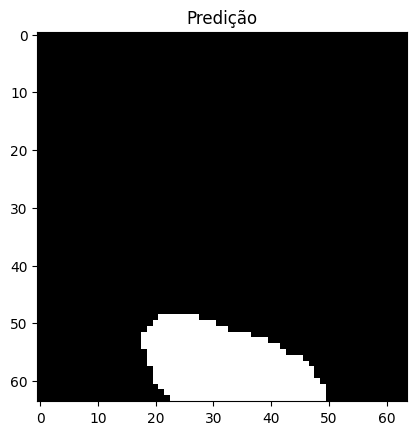

In [107]:
plt.imshow(predictions[0], cmap='gray')
plt.title('Predição')
plt.show()

In [108]:
iou_resultado = MeanIoU(num_classes=2)
iou_resultado.update_state(ground_truth, predictions)
iou = iou_resultado.result().numpy()
print('IoU para a imagem:', iou)

IoU para a imagem: 0.78811574


In [109]:
patche_cena.shape, patche_classe.shape

((550, 64, 64, 8), (550, 64, 64))

In [110]:
# import pandas as pd
# # IoU 53... 52
# valores_IoU = []
# iou_resultado = MeanIoU(num_classes=2)

# for idx in range(patche_cena.shape[0]):
#     img = patche_cena[idx]
#     ground_truth = patche_classe[idx]

#     img_test = img.reshape(1, 64, 64, 8)

#     predictions = model.predict(img_test)
#     predictions = tf.argmax(predictions, axis=-1)

#     ground_truth = ground_truth.reshape(1, 64, 64, 1)
#     ground_truth = tf.cast(ground_truth, tf.int64)

#     iou_resultado.update_state(ground_truth, predictions)  # atualização
#     iou = iou_resultado.result().numpy()
#     valores_IoU.append(iou)

#     iou_resultado.reset_states()

# df = pd.DataFrame(valores_IoU, columns=["IoU"])
# df = df[df.IoU != 1.0]

# media_IoU = df.mean().values
# print("Média do IoU para " + str(len(valores_IoU)) + " imagens: ", media_IoU)

In [111]:
def calcular_iou(id_img_teste, model, patche_cena_test, patche_classe_test):
    img_teste = patche_cena_test[id_img_teste]
    ground_truth = patche_classe_test[id_img_teste]

    iou_resultado = MeanIoU(num_classes=2)

    img_test = img_teste.reshape(1, 64, 64, 8)
    predictions = model.predict(img_test)
    predictions = tf.argmax(predictions, axis=-1)

    ground_truth = ground_truth.reshape(1, 64, 64, 1)
    ground_truth = tf.cast(ground_truth, tf.int64)

    iou_resultado.update_state(ground_truth, predictions)
    iou = iou_resultado.result()

    # fig, axs = plt.subplots(1, 2, figsize=(10, 5))

    # axs[0].imshow(np.squeeze(ground_truth), cmap='gray')
    # axs[0].set_title('Máscara real')

    # axs[1].imshow(predictions[0], cmap='gray')
    # axs[1].set_title('Predição')

    # plt.show()

    print(f'IoU para a imagem {id_img_teste}: {iou}')

    return iou

def calcular_media_iou(model, patche_cena_test, patche_classe_test):
    valores_iou = []
    for id_img_teste in range(len(patche_cena_test)):
        iou = calcular_iou(id_img_teste, model, patche_cena_test, patche_classe_test)
        valores_iou.append(iou)

    media_iou = np.mean(valores_iou)
    print(f'Média do IoU para todas as imagens: {media_iou}')

# Substitua 'patche_cena_test' e 'patche_classe_test' pelos seus dados reais
calcular_media_iou(model, patche_cena, patche_classe)


1/1 [==============================] - 0s 28ms/step
IoU para a imagem 0: 1.0
1/1 [==============================] - 0s 30ms/step
IoU para a imagem 1: 1.0
1/1 [==============================] - 0s 30ms/step
IoU para a imagem 2: 0.6354135274887085
1/1 [==============================] - 0s 42ms/step
IoU para a imagem 3: 1.0
1/1 [==============================] - 0s 34ms/step
IoU para a imagem 4: 1.0
1/1 [==============================] - 0s 30ms/step
IoU para a imagem 5: 1.0
1/1 [==============================] - 0s 29ms/step
IoU para a imagem 6: 1.0
1/1 [==============================] - 0s 33ms/step
IoU para a imagem 7: 1.0
1/1 [==============================] - 0s 36ms/step
IoU para a imagem 8: 1.0
1/1 [==============================] - 0s 27ms/step
IoU para a imagem 9: 1.0
1/1 [==============================] - 0s 28ms/step
IoU para a imagem 10: 1.0
1/1 [==============================] - 0s 27ms/step
IoU para a imagem 11: 0.4884033203125
1/1 [==============================] - 0s 33ms/

## 11: Conclusão
### A avaliação dos resultados foi melhor compreendida com a convergência do modelo de treinamento e a vizualização das segmentações dos rótudos feitas pelo algoritmo, assim verificando os rótulos verdadeiros separados do conjunto de teste, portanto generalizados. Em trabalhos futuros, deverão ser realizadas comparações com arquiteturas de modelos como a DeepLabV3 com utilização de mais classes, como o tamanho dos deslizamentos. Além disso, o processamento das imagens bitemporais deverão ser mais precisas, com registro (sem deslocamento) e um melhor segmento das máscaras de deslizamentos com a biblioteca RSGISLIb [4], considerando os mapas do site *Disasters Charter* como verdade de campo [5].

## Referências
  - [1] [Python for Geosciences: Raster Merging, Clipping and Reprojection with Rasterio](https://medium.com/analytics-vidhya/python-for-geosciences-raster-merging-clipping-and-reprojection-with-rasterio-9f05f012b88a)
  - [2] [Patch Generator](https://github.com/vdlucas-queiroz/patch_generator/)
  - [3] [Notebook WorkCAP Hackathon 2022](https://www.kaggle.com/code/grupohackaton2022/hackathon-notebook)
  - [4] [RSGISLib Image Segmentation Module](http://rsgislib.org/rsgislib_segmentation.html)
  - [5] [The International Charter Space and Major Disasters](https://disasterscharter.org/web/guest/activations/-/article/landslide-in-brazil-activation-758-)